<a href="https://colab.research.google.com/github/anishasingh23/MRI_XAI/blob/main/BrainTumour_XAI.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# **DATA and Imports**

In [ ]:
import os
import zipfile
import numpy as np
import matplotlib.pyplot as plt
from scipy.io import loadmat
import tensorflow as tf
from tensorflow.keras.applications import VGG16
from tensorflow.keras.models import Model
from tensorflow.keras.layers import Dense, Flatten, Dropout
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.callbacks import ModelCheckpoint, EarlyStopping
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from sklearn.model_selection import train_test_split
from PIL import Image
import cv2


Extracted folders: ['Testing', 'Training']
Training directory contents: ['notumor', 'pituitary', 'glioma', 'meningioma']


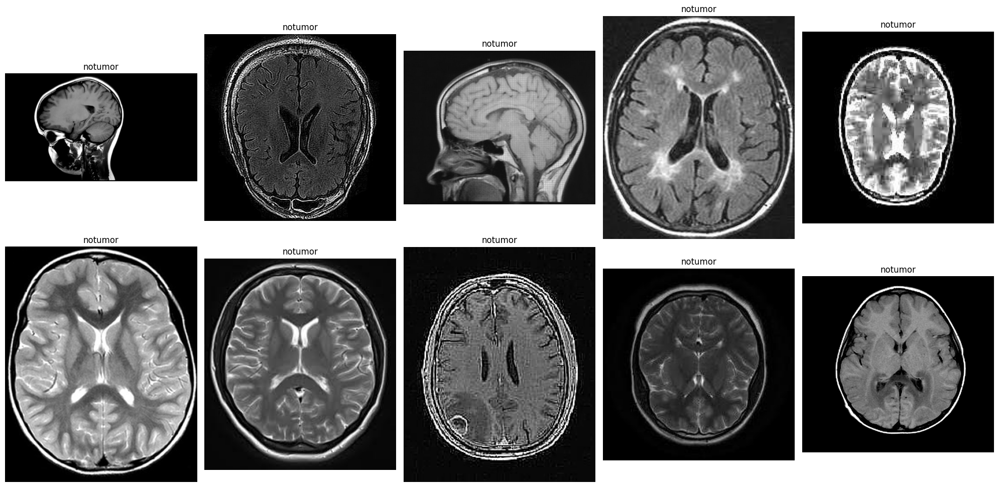

In [ ]:
import os
import zipfile
import matplotlib.pyplot as plt
from PIL import Image

# --- Step 1: Unzip the Dataset ---
zip_path = 'brain-tumor-mri-dataset.zip'
extract_dir = 'brain_tumor_datasets'

# Unzip the dataset if it hasn't been extracted already
if not os.path.exists(extract_dir):
    with zipfile.ZipFile(zip_path, 'r') as zip_ref:
        zip_ref.extractall(extract_dir)

# List the top-level directories (should show 'Training' and 'Testing')
print("Extracted folders:", os.listdir(extract_dir))

# Focus on the training data folder (which should contain your class subfolders)
train_dir = os.path.join(extract_dir, 'Training')
print("Training directory contents:", os.listdir(train_dir))

# --- Display 10 Sample Images ---
# We'll collect 10 images from the training dataset (across different classes)
sample_images = []
sample_titles = []  # To display the class names along with images

# Allowed image extensions
img_extensions = ('.jpg', '.jpeg', '.png')

# Loop over each class folder and collect images until we have 10
for class_name in os.listdir(train_dir):
    class_folder = os.path.join(train_dir, class_name)
    if os.path.isdir(class_folder):
        for file in os.listdir(class_folder):
            if file.lower().endswith(img_extensions):
                img_path = os.path.join(class_folder, file)
                try:
                    img = Image.open(img_path)
                    sample_images.append(img)
                    sample_titles.append(class_name)
                except Exception as e:
                    print(f"Error opening {img_path}: {e}")
                if len(sample_images) >= 10:
                    break
    if len(sample_images) >= 10:
        break

# Display the first 10 images
plt.figure(figsize=(20, 10))
for i, (img, title) in enumerate(zip(sample_images[:10], sample_titles[:10])):
    plt.subplot(2, 5, i+1)
    plt.imshow(img.convert("RGB"))
    plt.title(title)
    plt.axis('off')
plt.tight_layout()
plt.show()


In [ ]:
from tensorflow.keras.preprocessing.image import ImageDataGenerator

# Set image dimensions and batch size for VGG16 (which expects 224x224 RGB images)
img_width, img_height = 224, 224
batch_size = 32

# Define the directory to use (only the training data)
output_dir = os.path.join(extract_dir, 'Training')

# Create a training ImageDataGenerator with data augmentation and a validation split (20%)
train_datagen = ImageDataGenerator(
    rescale=1.0/255,
    rotation_range=40,
    width_shift_range=0.3,
    height_shift_range=0.3,
    shear_range=0.3,
    zoom_range=0.3,
    horizontal_flip=True,
    fill_mode='nearest',
    validation_split=0.2
)



# Create a validation ImageDataGenerator that only rescales the images
validation_datagen = ImageDataGenerator(
    rescale=1.0/255,
    validation_split=0.2
)

# Load training images with augmentation
train_generator = train_datagen.flow_from_directory(
    directory=output_dir,
    target_size=(img_width, img_height),
    batch_size=batch_size,
    class_mode='categorical',
    subset='training',
    color_mode='rgb',  # VGG16 expects 3-channel RGB images
    shuffle=True
)

# Load validation images (only rescaled)
validation_generator = validation_datagen.flow_from_directory(
    directory=output_dir,
    target_size=(img_width, img_height),
    batch_size=batch_size,
    class_mode='categorical',
    subset='validation',
    color_mode='rgb',
    shuffle=False  # Keeping validation order for consistent evaluation
)

# Print the class indices and number of samples for verification
print("Class indices:", train_generator.class_indices)
print("Total training images:", train_generator.samples)
print("Total validation images:", validation_generator.samples)


Found 4571 images belonging to 4 classes.
Found 1141 images belonging to 4 classes.
Class indices: {'glioma': 0, 'meningioma': 1, 'notumor': 2, 'pituitary': 3}
Total training images: 4571
Total validation images: 1141


# **Resnet with CBAM part 3 - 97.11**

Found 4571 images belonging to 4 classes.
Found 1141 images belonging to 4 classes.
94668760/94668760 ━━━━━━━━━━━━━━━━━━━━ 0s 0us/step

Epoch 1/70


/usr/local/lib/python3.11/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


143/143 ━━━━━━━━━━━━━━━━━━━━ 143s 699ms/step - accuracy: 0.7244 - loss: 15.9910 - val_accuracy: 0.8571 - val_loss: 8.0740
Precision: 0.8567 | Recall: 0.8576 | F1: 0.8560 | Val Accuracy: 0.8571

Epoch 2/70
143/143 ━━━━━━━━━━━━━━━━━━━━ 69s 484ms/step - accuracy: 0.9118 - loss: 6.8160 - val_accuracy: 0.8957 - val_loss: 4.3874
Precision: 0.8956 | Recall: 0.8959 | F1: 0.8937 | Val Accuracy: 0.8957
✅ val_accuracy increased.

Epoch 3/70
143/143 ━━━━━━━━━━━━━━━━━━━━ 71s 495ms/step - accuracy: 0.9172 - loss: 3.8315 - val_accuracy: 0.8817 - val_loss: 2.7714
Precision: 0.8866 | Recall: 0.8813 | F1: 0.8812 | Val Accuracy: 0.8817
⚠️ val_accuracy did not increase.

Epoch 4/70
143/143 ━━━━━━━━━━━━━━━━━━━━ 70s 492ms/step - accuracy: 0.9335 - loss: 2.4179 - val_accuracy: 0.8896 - val_loss: 1.8763
Precision: 0.8909 | Recall: 0.8918 | F1: 0.8890 | Val Accuracy: 0.8896
✅ val_accuracy increased.

Epoch 5/70
143/143 ━━━━━━━━━━━━━━━━━━━━ 77s 539ms/step - accuracy: 0.9477 - loss: 1.6661 - val_accuracy: 0.8931

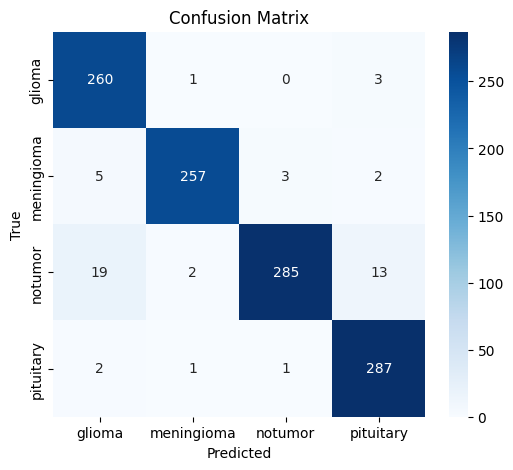

<ipython-input-6-7e7da6447d3b>:273: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  plt.legend()


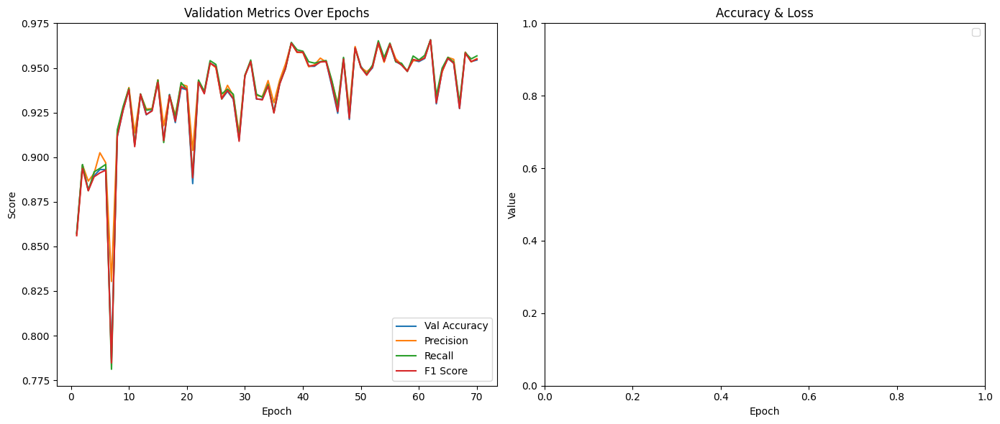

In [ ]:
import os
import zipfile
import numpy as np
import matplotlib.pyplot as plt
from tensorflow.keras.applications import ResNet50V2
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras.layers import (GlobalAveragePooling2D, Dense, Dropout, BatchNormalization,
                                     Multiply, Conv2D, Activation, Reshape, Concatenate, Layer, Input)
from tensorflow.keras.models import Model
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.callbacks import ModelCheckpoint, EarlyStopping, ReduceLROnPlateau, LearningRateScheduler
from tensorflow.keras.regularizers import l2
from tensorflow.keras import backend as K
from tensorflow.keras.losses import CategoricalCrossentropy
from sklearn.utils.class_weight import compute_class_weight
from PIL import Image
import tensorflow as tf
import random
from sklearn.metrics import classification_report, confusion_matrix, precision_score, recall_score, f1_score
import seaborn as sns

# ======================
# 1. CBAM LAYER IMPLEMENTATION
# ======================
class ChannelAttention(Layer):
    def __init__(self, ratio=8, **kwargs):
        super(ChannelAttention, self).__init__(**kwargs)
        self.ratio = ratio

    def build(self, input_shape):
        self.channel = input_shape[-1]
        self.shared_dense_one = Dense(self.channel // self.ratio, activation='swish')
        self.shared_dense_two = Dense(self.channel, activation='sigmoid')
        super(ChannelAttention, self).build(input_shape)

    def call(self, inputs):
        avg_pool = K.mean(inputs, axis=[1, 2], keepdims=True)
        max_pool = K.max(inputs, axis=[1, 2], keepdims=True)
        avg_out = self.shared_dense_two(self.shared_dense_one(avg_pool))
        max_out = self.shared_dense_two(self.shared_dense_one(max_pool))
        return Multiply()([inputs, avg_out + max_out])

class SpatialAttention(Layer):
    def __init__(self, kernel_size=7, **kwargs):
        super(SpatialAttention, self).__init__(**kwargs)
        self.conv = Conv2D(1, kernel_size, padding='same', activation='sigmoid')

    def call(self, inputs):
        avg_pool = K.mean(inputs, axis=-1, keepdims=True)
        max_pool = K.max(inputs, axis=-1, keepdims=True)
        concat = Concatenate()([avg_pool, max_pool])
        spatial = self.conv(concat)
        return Multiply()([inputs, spatial])

class CBAM(Layer):
    def __init__(self, ratio=8, kernel_size=7, **kwargs):
        super(CBAM, self).__init__(**kwargs)
        self.channel_attention = ChannelAttention(ratio)
        self.spatial_attention = SpatialAttention(kernel_size)

    def call(self, inputs):
        x = self.channel_attention(inputs)
        return self.spatial_attention(x)

# ======================
# 2. DATA PREPARATION
# ======================
def load_data():
    zip_path = 'brain-tumor-mri-dataset.zip'
    extract_dir = 'brain_tumor_datasets'

    if not os.path.exists(extract_dir):
        with zipfile.ZipFile(zip_path, 'r') as zip_ref:
            zip_ref.extractall(extract_dir)

    train_dir = os.path.join(extract_dir, 'Training')

    # Augmentation
    train_datagen = ImageDataGenerator(
        rescale=1./255,
        rotation_range=45,
        width_shift_range=0.25,
        height_shift_range=0.25,
        shear_range=0.2,
        zoom_range=0.3,
        brightness_range=[0.7, 1.3],
        horizontal_flip=True,
        vertical_flip=True,
        fill_mode='reflect',
        validation_split=0.2
    )

    val_datagen = ImageDataGenerator(
        rescale=1./255,
        validation_split=0.2
    )

    train_generator = train_datagen.flow_from_directory(
        train_dir,
        target_size=(224, 224),
        batch_size=32,
        class_mode='categorical',
        subset='training',
        shuffle=True,
        seed=42
    )

    val_generator = val_datagen.flow_from_directory(
        train_dir,
        target_size=(224, 224),
        batch_size=32,
        class_mode='categorical',
        subset='validation',
        shuffle=False,
        seed=42
    )

    return train_generator, val_generator

# ======================
# 3. RESNET50V2 + CBAM MODEL
# ======================
def build_model():
    base_model = ResNet50V2(
        weights='imagenet',
        include_top=False,
        input_shape=(224, 224, 3)
    )

    for layer in base_model.layers[:100]:
        layer.trainable = False

    x1 = base_model.get_layer('conv3_block4_out').output
    x1 = CBAM()(x1)
    x1 = GlobalAveragePooling2D()(x1)

    x2 = base_model.get_layer('conv4_block6_out').output
    x2 = CBAM()(x2)
    x2 = GlobalAveragePooling2D()(x2)

    x3 = base_model.output
    x3 = CBAM()(x3)
    x3 = GlobalAveragePooling2D()(x3)

    fused = Concatenate()([x1, x2, x3])

    x = Dense(1024, kernel_regularizer=l2(0.01))(fused)
    x = BatchNormalization()(x)
    x = Activation('swish')(x)
    x = Dropout(0.6)(x)

    x = Dense(512, kernel_regularizer=l2(0.005))(x)
    x = BatchNormalization()(x)
    x = Activation('swish')(x)
    x = Dropout(0.5)(x)

    predictions = Dense(4, activation='softmax')(x)

    return Model(inputs=base_model.input, outputs=predictions)

# ======================
# 4. TRAINING LOOP
# ======================


def train_and_evaluate():
    train_gen, val_gen = load_data()
    model = build_model()

    class_weights = compute_class_weight(
        class_weight='balanced',
        classes=np.unique(train_gen.classes),
        y=train_gen.labels
    )
    class_weights = dict(enumerate(class_weights))

    val_acc_best = 0
    metrics_by_epoch = {
        'precision': [], 'recall': [], 'f1': [], 'val_accuracy': []
    }
    best_metrics = {'epoch': 0, 'precision': 0, 'recall': 0, 'f1': 0, 'val_accuracy': 0}

    def lr_schedule(epoch):
        if epoch < 15:
            return 3e-4
        elif epoch < 30:
            return 1e-4
        else:
            return 5e-5

    model.compile(
        optimizer=Adam(learning_rate=3e-4),
        loss=CategoricalCrossentropy(label_smoothing=0.1),
        metrics=['accuracy']
    )

    for epoch in range(70):
        print(f"\nEpoch {epoch+1}/70")
        model.fit(train_gen, epochs=1, validation_data=val_gen, class_weight=class_weights, verbose=1)

        val_preds = model.predict(val_gen, verbose=0)
        y_pred = np.argmax(val_preds, axis=1)
        y_true = val_gen.classes

        precision = precision_score(y_true, y_pred, average='macro')
        recall = recall_score(y_true, y_pred, average='macro')
        f1 = f1_score(y_true, y_pred, average='macro')
        val_acc = np.mean(y_pred == y_true)

        metrics_by_epoch['precision'].append(precision)
        metrics_by_epoch['recall'].append(recall)
        metrics_by_epoch['f1'].append(f1)
        metrics_by_epoch['val_accuracy'].append(val_acc)

        print(f"Precision: {precision:.4f} | Recall: {recall:.4f} | F1: {f1:.4f} | Val Accuracy: {val_acc:.4f}")
        if epoch > 0:
            if val_acc > metrics_by_epoch['val_accuracy'][epoch-1]:
                print("✅ val_accuracy increased.")
            else:
                print("⚠️ val_accuracy did not increase.")

        if precision > best_metrics['precision']:
            best_metrics['precision'] = precision
            best_metrics['epoch'] = epoch + 1
        if recall > best_metrics['recall']:
            best_metrics['recall'] = recall
        if f1 > best_metrics['f1']:
            best_metrics['f1'] = f1
        if val_acc > best_metrics['val_accuracy']:
            best_metrics['val_accuracy'] = val_acc

    print("\n🎯 Best Metrics Summary:")
    print(f"Epoch: {best_metrics['epoch']}")
    print(f"Best Precision: {best_metrics['precision']:.4f}")
    print(f"Best Recall: {best_metrics['recall']:.4f}")
    print(f"Best F1-Score: {best_metrics['f1']:.4f}")
    print(f"Best Val Accuracy: {best_metrics['val_accuracy']:.4f}")

    # Final confusion matrix
    cm = confusion_matrix(y_true, y_pred)
    plt.figure(figsize=(6, 5))
    sns.heatmap(cm, annot=True, fmt='d', cmap='Blues', xticklabels=val_gen.class_indices.keys(), yticklabels=val_gen.class_indices.keys())
    plt.title("Confusion Matrix")
    plt.xlabel("Predicted")
    plt.ylabel("True")
    plt.savefig('confusion_matrix.png')
    plt.show()

    # Plot metrics
    epochs = range(1, 71)
    plt.figure(figsize=(14, 6))
    plt.subplot(1, 2, 1)
    plt.plot(epochs, metrics_by_epoch['val_accuracy'], label='Val Accuracy')
    plt.plot(epochs, metrics_by_epoch['precision'], label='Precision')
    plt.plot(epochs, metrics_by_epoch['recall'], label='Recall')
    plt.plot(epochs, metrics_by_epoch['f1'], label='F1 Score')
    plt.title("Validation Metrics Over Epochs")
    plt.xlabel("Epoch")
    plt.ylabel("Score")
    plt.legend()

    plt.subplot(1, 2, 2)
    history = model.history.history
    if 'accuracy' in history:
        plt.plot(history.get('accuracy', []), label='Train Accuracy')
        plt.plot(history.get('val_accuracy', []), label='Val Accuracy')
    if 'loss' in history:
        plt.plot(history.get('loss', []), label='Train Loss')
        plt.plot(history.get('val_loss', []), label='Val Loss')
    plt.title("Accuracy & Loss")
    plt.xlabel("Epoch")
    plt.ylabel("Value")
    plt.legend()

    plt.tight_layout()
    plt.savefig('all_metrics_plot.png')
    plt.show()

    return model

# ======================
# 5. MAIN EXECUTION
# ======================
if __name__ == "__main__":
    trained_model = train_and_evaluate()
    trained_model.save('brain_tumor_cbam_mode2.h5')


Found 4571 images belonging to 4 classes.
Found 1141 images belonging to 4 classes.


/usr/local/lib/python3.11/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/70
143/143 ━━━━━━━━━━━━━━━━━━━━ 0s 563ms/step - accuracy: 0.7343 - loss: 16.8982
Epoch 1: val_accuracy improved from -inf to 0.85714, saving model to best_model.h5


143/143 ━━━━━━━━━━━━━━━━━━━━ 129s 655ms/step - accuracy: 0.7349 - loss: 16.8775 - val_accuracy: 0.8571 - val_loss: 9.3413 - learning_rate: 3.0000e-04
Epoch 2/70
143/143 ━━━━━━━━━━━━━━━━━━━━ 0s 472ms/step - accuracy: 0.8863 - loss: 7.7971
Epoch 2: val_accuracy improved from 0.85714 to 0.87555, saving model to best_model.h5


143/143 ━━━━━━━━━━━━━━━━━━━━ 110s 535ms/step - accuracy: 0.8863 - loss: 7.7892 - val_accuracy: 0.8755 - val_loss: 4.7958 - learning_rate: 3.0000e-04
Epoch 3/70
143/143 ━━━━━━━━━━━━━━━━━━━━ 0s 465ms/step - accuracy: 0.9243 - loss: 4.1663
Epoch 3: val_accuracy improved from 0.87555 to 0.89132, saving model to best_model.h5


143/143 ━━━━━━━━━━━━━━━━━━━━ 76s 530ms/step - accuracy: 0.9243 - loss: 4.1629 - val_accuracy: 0.8913 - val_loss: 2.8998 - learning_rate: 3.0000e-04
Epoch 4/70
143/143 ━━━━━━━━━━━━━━━━━━━━ 0s 480ms/step - accuracy: 0.9336 - loss: 2.5802
Epoch 4: val_accuracy improved from 0.89132 to 0.91323, saving model to best_model.h5


143/143 ━━━━━━━━━━━━━━━━━━━━ 73s 511ms/step - accuracy: 0.9336 - loss: 2.5786 - val_accuracy: 0.9132 - val_loss: 2.0605 - learning_rate: 3.0000e-04
Epoch 5/70
143/143 ━━━━━━━━━━━━━━━━━━━━ 0s 477ms/step - accuracy: 0.9490 - loss: 1.7524
Epoch 5: val_accuracy improved from 0.91323 to 0.92463, saving model to best_model.h5


143/143 ━━━━━━━━━━━━━━━━━━━━ 78s 548ms/step - accuracy: 0.9490 - loss: 1.7516 - val_accuracy: 0.9246 - val_loss: 1.4617 - learning_rate: 3.0000e-04
Epoch 6/70
143/143 ━━━━━━━━━━━━━━━━━━━━ 0s 468ms/step - accuracy: 0.9575 - loss: 1.2810
Epoch 6: val_accuracy improved from 0.92463 to 0.94479, saving model to best_model.h5


143/143 ━━━━━━━━━━━━━━━━━━━━ 74s 513ms/step - accuracy: 0.9574 - loss: 1.2806 - val_accuracy: 0.9448 - val_loss: 1.4030 - learning_rate: 3.0000e-04
Epoch 7/70
143/143 ━━━━━━━━━━━━━━━━━━━━ 0s 469ms/step - accuracy: 0.9499 - loss: 1.0469
Epoch 7: val_accuracy did not improve from 0.94479
143/143 ━━━━━━━━━━━━━━━━━━━━ 73s 506ms/step - accuracy: 0.9500 - loss: 1.0464 - val_accuracy: 0.9246 - val_loss: 1.0338 - learning_rate: 3.0000e-04
Epoch 8/70
143/143 ━━━━━━━━━━━━━━━━━━━━ 0s 480ms/step - accuracy: 0.9601 - loss: 0.8548
Epoch 8: val_accuracy did not improve from 0.94479
143/143 ━━━━━━━━━━━━━━━━━━━━ 72s 501ms/step - accuracy: 0.9601 - loss: 0.8549 - val_accuracy: 0.9325 - val_loss: 0.8672 - learning_rate: 3.0000e-04
Epoch 9/70
143/143 ━━━━━━━━━━━━━━━━━━━━ 0s 477ms/step - accuracy: 0.9420 - loss: 0.8055
Epoch 9: val_accuracy did not improve from 0.94479
143/143 ━━━━━━━━━━━━━━━━━━━━ 81s 498ms/step - accuracy: 0.9421 - loss: 0.8052 - val_accuracy: 0.8992 - val_loss: 0.8407 - learning_rate: 3.

143/143 ━━━━━━━━━━━━━━━━━━━━ 77s 537ms/step - accuracy: 0.9654 - loss: 0.5651 - val_accuracy: 0.9588 - val_loss: 0.5602 - learning_rate: 3.0000e-04
Epoch 14/70
143/143 ━━━━━━━━━━━━━━━━━━━━ 0s 472ms/step - accuracy: 0.9711 - loss: 0.5234
Epoch 14: val_accuracy did not improve from 0.95881
143/143 ━━━━━━━━━━━━━━━━━━━━ 70s 491ms/step - accuracy: 0.9711 - loss: 0.5234 - val_accuracy: 0.7073 - val_loss: 1.4416 - learning_rate: 3.0000e-04
Epoch 15/70
143/143 ━━━━━━━━━━━━━━━━━━━━ 0s 474ms/step - accuracy: 0.9734 - loss: 0.5097
Epoch 15: val_accuracy did not improve from 0.95881
143/143 ━━━━━━━━━━━━━━━━━━━━ 71s 495ms/step - accuracy: 0.9734 - loss: 0.5097 - val_accuracy: 0.9246 - val_loss: 0.5940 - learning_rate: 3.0000e-04
Epoch 16/70
143/143 ━━━━━━━━━━━━━━━━━━━━ 0s 475ms/step - accuracy: 0.9781 - loss: 0.4819
Epoch 16: val_accuracy did not improve from 0.95881
143/143 ━━━━━━━━━━━━━━━━━━━━ 71s 498ms/step - accuracy: 0.9781 - loss: 0.4818 - val_accuracy: 0.9413 - val_loss: 0.5277 - learning_ra

143/143 ━━━━━━━━━━━━━━━━━━━━ 86s 542ms/step - accuracy: 0.9853 - loss: 0.4331 - val_accuracy: 0.9606 - val_loss: 0.4691 - learning_rate: 1.0000e-04
Epoch 22/70
143/143 ━━━━━━━━━━━━━━━━━━━━ 0s 468ms/step - accuracy: 0.9888 - loss: 0.4219
Epoch 22: val_accuracy did not improve from 0.96056
143/143 ━━━━━━━━━━━━━━━━━━━━ 75s 490ms/step - accuracy: 0.9888 - loss: 0.4219 - val_accuracy: 0.9562 - val_loss: 0.4805 - learning_rate: 1.0000e-04
Epoch 23/70
143/143 ━━━━━━━━━━━━━━━━━━━━ 0s 466ms/step - accuracy: 0.9878 - loss: 0.4184
Epoch 23: val_accuracy did not improve from 0.96056
143/143 ━━━━━━━━━━━━━━━━━━━━ 72s 502ms/step - accuracy: 0.9878 - loss: 0.4184 - val_accuracy: 0.9544 - val_loss: 0.4856 - learning_rate: 1.0000e-04
Epoch 24/70
143/143 ━━━━━━━━━━━━━━━━━━━━ 0s 473ms/step - accuracy: 0.9892 - loss: 0.4151
Epoch 24: val_accuracy did not improve from 0.96056
143/143 ━━━━━━━━━━━━━━━━━━━━ 73s 510ms/step - accuracy: 0.9892 - loss: 0.4151 - val_accuracy: 0.9562 - val_loss: 0.4783 - learning_ra

143/143 ━━━━━━━━━━━━━━━━━━━━ 79s 555ms/step - accuracy: 0.9857 - loss: 0.4188 - val_accuracy: 0.9641 - val_loss: 0.5042 - learning_rate: 1.0000e-04
Epoch 26/70
143/143 ━━━━━━━━━━━━━━━━━━━━ 0s 473ms/step - accuracy: 0.9883 - loss: 0.4151
Epoch 26: val_accuracy did not improve from 0.96407
143/143 ━━━━━━━━━━━━━━━━━━━━ 70s 492ms/step - accuracy: 0.9882 - loss: 0.4151 - val_accuracy: 0.9483 - val_loss: 0.4890 - learning_rate: 5.0000e-05
Epoch 27/70
143/143 ━━━━━━━━━━━━━━━━━━━━ 0s 471ms/step - accuracy: 0.9893 - loss: 0.4104
Epoch 27: val_accuracy did not improve from 0.96407
143/143 ━━━━━━━━━━━━━━━━━━━━ 70s 490ms/step - accuracy: 0.9893 - loss: 0.4104 - val_accuracy: 0.9544 - val_loss: 0.4811 - learning_rate: 1.0000e-04
Epoch 28/70
143/143 ━━━━━━━━━━━━━━━━━━━━ 0s 480ms/step - accuracy: 0.9902 - loss: 0.4105
Epoch 28: val_accuracy did not improve from 0.96407
143/143 ━━━━━━━━━━━━━━━━━━━━ 72s 502ms/step - accuracy: 0.9902 - loss: 0.4105 - val_accuracy: 0.9641 - val_loss: 0.4462 - learning_ra

143/143 ━━━━━━━━━━━━━━━━━━━━ 76s 531ms/step - accuracy: 0.9913 - loss: 0.4043 - val_accuracy: 0.9649 - val_loss: 0.4611 - learning_rate: 1.0000e-04
Epoch 30/70
143/143 ━━━━━━━━━━━━━━━━━━━━ 0s 474ms/step - accuracy: 0.9905 - loss: 0.4052
Epoch 30: val_accuracy did not improve from 0.96494
143/143 ━━━━━━━━━━━━━━━━━━━━ 71s 493ms/step - accuracy: 0.9905 - loss: 0.4053 - val_accuracy: 0.9465 - val_loss: 0.5108 - learning_rate: 1.0000e-04
Epoch 31/70
143/143 ━━━━━━━━━━━━━━━━━━━━ 0s 466ms/step - accuracy: 0.9874 - loss: 0.4075
Epoch 31: val_accuracy did not improve from 0.96494
143/143 ━━━━━━━━━━━━━━━━━━━━ 70s 488ms/step - accuracy: 0.9874 - loss: 0.4074 - val_accuracy: 0.9527 - val_loss: 0.4686 - learning_rate: 5.0000e-05
Epoch 32/70
143/143 ━━━━━━━━━━━━━━━━━━━━ 0s 473ms/step - accuracy: 0.9890 - loss: 0.4072
Epoch 32: val_accuracy did not improve from 0.96494
143/143 ━━━━━━━━━━━━━━━━━━━━ 70s 492ms/step - accuracy: 0.9890 - loss: 0.4071 - val_accuracy: 0.9562 - val_loss: 0.4651 - learning_ra

143/143 ━━━━━━━━━━━━━━━━━━━━ 77s 536ms/step - accuracy: 0.9944 - loss: 0.3921 - val_accuracy: 0.9676 - val_loss: 0.4524 - learning_rate: 5.0000e-05
Epoch 38/70
143/143 ━━━━━━━━━━━━━━━━━━━━ 0s 474ms/step - accuracy: 0.9914 - loss: 0.3916
Epoch 38: val_accuracy did not improve from 0.96757
143/143 ━━━━━━━━━━━━━━━━━━━━ 71s 494ms/step - accuracy: 0.9913 - loss: 0.3916 - val_accuracy: 0.9623 - val_loss: 0.4537 - learning_rate: 2.5000e-05
Epoch 39/70
143/143 ━━━━━━━━━━━━━━━━━━━━ 0s 476ms/step - accuracy: 0.9909 - loss: 0.3971
Epoch 39: val_accuracy did not improve from 0.96757
143/143 ━━━━━━━━━━━━━━━━━━━━ 71s 496ms/step - accuracy: 0.9909 - loss: 0.3971 - val_accuracy: 0.9492 - val_loss: 0.4857 - learning_rate: 5.0000e-05
Epoch 40/70
143/143 ━━━━━━━━━━━━━━━━━━━━ 0s 471ms/step - accuracy: 0.9922 - loss: 0.3880
Epoch 40: val_accuracy did not improve from 0.96757
143/143 ━━━━━━━━━━━━━━━━━━━━ 71s 495ms/step - accuracy: 0.9922 - loss: 0.3880 - val_accuracy: 0.9658 - val_loss: 0.4351 - learning_ra

143/143 ━━━━━━━━━━━━━━━━━━━━ 78s 545ms/step - accuracy: 0.9967 - loss: 0.3761 - val_accuracy: 0.9693 - val_loss: 0.4384 - learning_rate: 5.0000e-05
Epoch 70/70
143/143 ━━━━━━━━━━━━━━━━━━━━ 0s 467ms/step - accuracy: 0.9944 - loss: 0.3796
Epoch 70: val_accuracy did not improve from 0.96933
143/143 ━━━━━━━━━━━━━━━━━━━━ 70s 491ms/step - accuracy: 0.9944 - loss: 0.3796 - val_accuracy: 0.9527 - val_loss: 0.4782 - learning_rate: 2.5000e-05


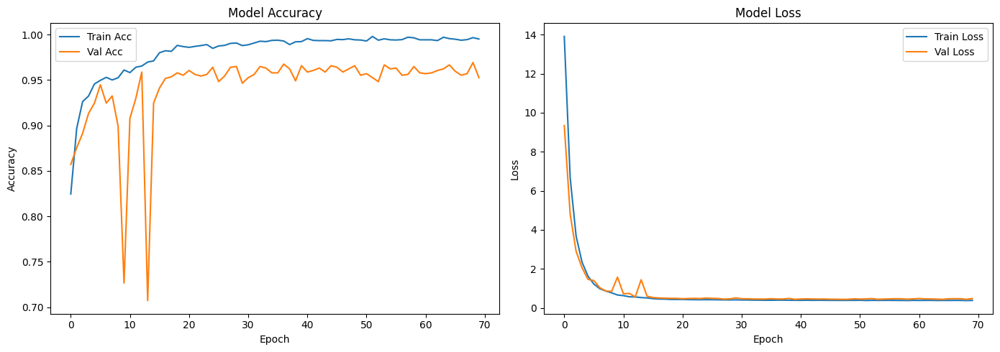

36/36 ━━━━━━━━━━━━━━━━━━━━ 3s 75ms/step - accuracy: 0.9733 - loss: 0.4187



Final Validation Accuracy: 0.9658
Final Validation Loss: 0.4351


In [ ]:
import os
import zipfile
import numpy as np
import matplotlib.pyplot as plt
from tensorflow.keras.applications import ResNet50V2
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras.layers import (GlobalAveragePooling2D, Dense, Dropout, BatchNormalization,
                                     Multiply, Conv2D, Activation, Reshape, Concatenate, Layer, Input)
from tensorflow.keras.models import Model
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.callbacks import ModelCheckpoint, EarlyStopping, ReduceLROnPlateau, LearningRateScheduler
from tensorflow.keras.regularizers import l2
from tensorflow.keras import backend as K
from tensorflow.keras.losses import CategoricalCrossentropy
from sklearn.utils.class_weight import compute_class_weight
from PIL import Image
import tensorflow as tf
import random

# ======================
# 1. CBAM LAYER IMPLEMENTATION
# ======================
class ChannelAttention(Layer):
    def __init__(self, ratio=8, **kwargs):
        super(ChannelAttention, self).__init__(**kwargs)
        self.ratio = ratio

    def build(self, input_shape):
        self.channel = input_shape[-1]
        self.shared_dense_one = Dense(self.channel // self.ratio, activation='swish')
        self.shared_dense_two = Dense(self.channel, activation='sigmoid')
        super(ChannelAttention, self).build(input_shape)

    def call(self, inputs):
        avg_pool = K.mean(inputs, axis=[1, 2], keepdims=True)
        max_pool = K.max(inputs, axis=[1, 2], keepdims=True)
        avg_out = self.shared_dense_two(self.shared_dense_one(avg_pool))
        max_out = self.shared_dense_two(self.shared_dense_one(max_pool))
        return Multiply()([inputs, avg_out + max_out])

class SpatialAttention(Layer):
    def __init__(self, kernel_size=7, **kwargs):
        super(SpatialAttention, self).__init__(**kwargs)
        self.conv = Conv2D(1, kernel_size, padding='same', activation='sigmoid')

    def call(self, inputs):
        avg_pool = K.mean(inputs, axis=-1, keepdims=True)
        max_pool = K.max(inputs, axis=-1, keepdims=True)
        concat = Concatenate()([avg_pool, max_pool])
        spatial = self.conv(concat)
        return Multiply()([inputs, spatial])

class CBAM(Layer):
    def __init__(self, ratio=8, kernel_size=7, **kwargs):
        super(CBAM, self).__init__(**kwargs)
        self.channel_attention = ChannelAttention(ratio)
        self.spatial_attention = SpatialAttention(kernel_size)

    def call(self, inputs):
        x = self.channel_attention(inputs)
        return self.spatial_attention(x)

# ======================
# 2. DATA PREPARATION
# ======================
def load_data():
    zip_path = 'brain-tumor-mri-dataset.zip'
    extract_dir = 'brain_tumor_datasets'

    if not os.path.exists(extract_dir):
        with zipfile.ZipFile(zip_path, 'r') as zip_ref:
            zip_ref.extractall(extract_dir)

    train_dir = os.path.join(extract_dir, 'Training')

    # Augmentation
    train_datagen = ImageDataGenerator(
        rescale=1./255,
        rotation_range=45,
        width_shift_range=0.25,
        height_shift_range=0.25,
        shear_range=0.2,
        zoom_range=0.3,
        brightness_range=[0.7, 1.3],
        horizontal_flip=True,
        vertical_flip=True,
        fill_mode='reflect',
        validation_split=0.2
    )

    val_datagen = ImageDataGenerator(
        rescale=1./255,
        validation_split=0.2
    )

    train_generator = train_datagen.flow_from_directory(
        train_dir,
        target_size=(224, 224),
        batch_size=32,
        class_mode='categorical',
        subset='training',
        shuffle=True,
        seed=42
    )

    val_generator = val_datagen.flow_from_directory(
        train_dir,
        target_size=(224, 224),
        batch_size=32,
        class_mode='categorical',
        subset='validation',
        shuffle=False,
        seed=42
    )

    return train_generator, val_generator

# ======================
# 3. RESNET50V2 + CBAM MODEL
# ======================
def build_model():
    base_model = ResNet50V2(
        weights='imagenet',
        include_top=False,
        input_shape=(224, 224, 3)
    )

    for layer in base_model.layers[:100]:
        layer.trainable = False

    x1 = base_model.get_layer('conv3_block4_out').output
    x1 = CBAM()(x1)
    x1 = GlobalAveragePooling2D()(x1)

    x2 = base_model.get_layer('conv4_block6_out').output
    x2 = CBAM()(x2)
    x2 = GlobalAveragePooling2D()(x2)

    x3 = base_model.output
    x3 = CBAM()(x3)
    x3 = GlobalAveragePooling2D()(x3)

    fused = Concatenate()([x1, x2, x3])

    x = Dense(1024, kernel_regularizer=l2(0.01))(fused)
    x = BatchNormalization()(x)
    x = Activation('swish')(x)
    x = Dropout(0.6)(x)

    x = Dense(512, kernel_regularizer=l2(0.005))(x)
    x = BatchNormalization()(x)
    x = Activation('swish')(x)
    x = Dropout(0.5)(x)

    predictions = Dense(4, activation='softmax')(x)

    return Model(inputs=base_model.input, outputs=predictions)

# ======================
# 4. TRAINING LOOP
# ======================
def train_and_evaluate():
    train_gen, val_gen = load_data()
    model = build_model()

    class_weights = compute_class_weight(
        class_weight='balanced',
        classes=np.unique(train_gen.classes),
        y=train_gen.labels  # <--- FIXED: use .labels not .classes
    )
    class_weights = dict(enumerate(class_weights))

    def lr_schedule(epoch):
        if epoch < 15:
            return 3e-4
        elif epoch < 30:
            return 1e-4
        else:
            return 5e-5

    callbacks = [
        ModelCheckpoint('best_model.h5', monitor='val_accuracy', save_best_only=True, verbose=1),
        EarlyStopping(monitor='val_loss', patience=50, restore_best_weights=True),
        ReduceLROnPlateau(monitor='val_loss', factor=0.5, patience=5, min_lr=1e-6),
        LearningRateScheduler(lr_schedule)
    ]

    model.compile(
        optimizer=Adam(learning_rate=3e-4),
        loss=CategoricalCrossentropy(label_smoothing=0.1),
        metrics=['accuracy']
    )

    history = model.fit(
        train_gen,
        validation_data=val_gen,
        epochs=70,
        callbacks=callbacks,
        class_weight=class_weights
    )

    # Plot
    plt.figure(figsize=(14, 5))

    plt.subplot(1, 2, 1)
    plt.plot(history.history['accuracy'], label='Train Acc')
    plt.plot(history.history['val_accuracy'], label='Val Acc')
    plt.title("Model Accuracy")
    plt.xlabel("Epoch")
    plt.ylabel("Accuracy")
    plt.legend()

    plt.subplot(1, 2, 2)
    plt.plot(history.history['loss'], label='Train Loss')
    plt.plot(history.history['val_loss'], label='Val Loss')
    plt.title("Model Loss")
    plt.xlabel("Epoch")
    plt.ylabel("Loss")
    plt.legend()

    plt.tight_layout()
    plt.savefig('training_history.png')
    plt.show()

    val_loss, val_acc = model.evaluate(val_gen)
    print(f"\nFinal Validation Accuracy: {val_acc:.4f}")
    print(f"Final Validation Loss: {val_loss:.4f}")

    return model

# ======================
# 5. MAIN EXECUTION
# ======================
if __name__ == "__main__":
    trained_model = train_and_evaluate()
    trained_model.save('brain_tumor_cbam_mode2.h5')


# **hhh**

In [ ]:
# import os
# import zipfile
# import numpy as np
# import matplotlib.pyplot as plt
# from tensorflow.keras.applications import ResNet50V2
# from tensorflow.keras.preprocessing.image import ImageDataGenerator
# from tensorflow.keras.layers import (GlobalAveragePooling2D, Dense, Dropout, BatchNormalization,
#                                      Multiply, Conv2D, Activation, Reshape, Concatenate, Layer, Input)
# from tensorflow.keras.models import Model
# from tensorflow.keras.optimizers import Adam
# from tensorflow.keras.callbacks import ModelCheckpoint, EarlyStopping, ReduceLROnPlateau, LearningRateScheduler
# from tensorflow.keras.regularizers import l2
# from tensorflow.keras import backend as K
# from tensorflow.keras.losses import CategoricalCrossentropy
# from sklearn.utils.class_weight import compute_class_weight
# from PIL import Image
# import tensorflow as tf
# import random
# from sklearn.metrics import precision_score, recall_score, f1_score


# # ======================
# # 1. CBAM LAYER IMPLEMENTATION
# # ======================
# class ChannelAttention(Layer):
#     def __init__(self, ratio=8, **kwargs):
#         super(ChannelAttention, self).__init__(**kwargs)
#         self.ratio = ratio

#     def build(self, input_shape):
#         self.channel = input_shape[-1]
#         self.shared_dense_one = Dense(self.channel // self.ratio, activation='swish')
#         self.shared_dense_two = Dense(self.channel, activation='sigmoid')
#         super(ChannelAttention, self).build(input_shape)

#     def call(self, inputs):
#         avg_pool = K.mean(inputs, axis=[1, 2], keepdims=True)
#         max_pool = K.max(inputs, axis=[1, 2], keepdims=True)
#         avg_out = self.shared_dense_two(self.shared_dense_one(avg_pool))
#         max_out = self.shared_dense_two(self.shared_dense_one(max_pool))
#         return Multiply()([inputs, avg_out + max_out])

# class SpatialAttention(Layer):
#     def __init__(self, kernel_size=7, **kwargs):
#         super(SpatialAttention, self).__init__(**kwargs)
#         self.conv = Conv2D(1, kernel_size, padding='same', activation='sigmoid')

#     def call(self, inputs):
#         avg_pool = K.mean(inputs, axis=-1, keepdims=True)
#         max_pool = K.max(inputs, axis=-1, keepdims=True)
#         concat = Concatenate()([avg_pool, max_pool])
#         spatial = self.conv(concat)
#         return Multiply()([inputs, spatial])

# class CBAM(Layer):
#     def __init__(self, ratio=8, kernel_size=7, **kwargs):
#         super(CBAM, self).__init__(**kwargs)
#         self.channel_attention = ChannelAttention(ratio)
#         self.spatial_attention = SpatialAttention(kernel_size)

#     def call(self, inputs):
#         x = self.channel_attention(inputs)
#         return self.spatial_attention(x)

# # ======================
# # 2. DATA PREPARATION
# # ======================
# def load_data():
#     zip_path = 'brain-tumor-mri-dataset.zip'
#     extract_dir = 'brain_tumor_datasets'

#     if not os.path.exists(extract_dir):
#         with zipfile.ZipFile(zip_path, 'r') as zip_ref:
#             zip_ref.extractall(extract_dir)

#     train_dir = os.path.join(extract_dir, 'Training')

#     # Augmentation
#     train_datagen = ImageDataGenerator(
#         rescale=1./255,
#         rotation_range=45,
#         width_shift_range=0.25,
#         height_shift_range=0.25,
#         shear_range=0.2,
#         zoom_range=0.3,
#         brightness_range=[0.7, 1.3],
#         horizontal_flip=True,
#         vertical_flip=True,
#         fill_mode='reflect',
#         validation_split=0.2
#     )

#     val_datagen = ImageDataGenerator(
#         rescale=1./255,
#         validation_split=0.2
#     )

#     train_generator = train_datagen.flow_from_directory(
#         train_dir,
#         target_size=(224, 224),
#         batch_size=32,
#         class_mode='categorical',
#         subset='training',
#         shuffle=True,
#         seed=42
#     )

#     val_generator = val_datagen.flow_from_directory(
#         train_dir,
#         target_size=(224, 224),
#         batch_size=32,
#         class_mode='categorical',
#         subset='validation',
#         shuffle=False,
#         seed=42
#     )

#     return train_generator, val_generator

# # ======================
# # 3. RESNET50V2 + CBAM MODEL
# # ======================
# def build_model():
#     base_model = ResNet50V2(
#         weights='imagenet',
#         include_top=False,
#         input_shape=(224, 224, 3)
#     )

#     for layer in base_model.layers[:100]:
#         layer.trainable = False

#     x1 = base_model.get_layer('conv3_block4_out').output
#     x1 = CBAM()(x1)
#     x1 = GlobalAveragePooling2D()(x1)

#     x2 = base_model.get_layer('conv4_block6_out').output
#     x2 = CBAM()(x2)
#     x2 = GlobalAveragePooling2D()(x2)

#     x3 = base_model.output
#     x3 = CBAM()(x3)
#     x3 = GlobalAveragePooling2D()(x3)

#     fused = Concatenate()([x1, x2, x3])

#     x = Dense(1024, kernel_regularizer=l2(0.01))(fused)
#     x = BatchNormalization()(x)
#     x = Activation('swish')(x)
#     x = Dropout(0.6)(x)

#     x = Dense(512, kernel_regularizer=l2(0.005))(x)
#     x = BatchNormalization()(x)
#     x = Activation('swish')(x)
#     x = Dropout(0.5)(x)

#     predictions = Dense(4, activation='softmax')(x)

#     return Model(inputs=base_model.input, outputs=predictions)

# # ======================
# # 4. TRAINING LOOP
# # ======================

# def train_and_evaluate():
#     train_gen, val_gen = load_data()
#     model = build_model()

#     class_weights = compute_class_weight(
#         class_weight='balanced',
#         classes=np.unique(train_gen.classes),
#         y=train_gen.labels
#     )
#     class_weights = dict(enumerate(class_weights))

#     def lr_schedule(epoch):
#         if epoch < 15:
#             return 3e-4
#         elif epoch < 30:
#             return 1e-4
#         else:
#             return 5e-5

#     callbacks = [
#         ModelCheckpoint('best_model.h5', monitor='val_accuracy', save_best_only=True, verbose=1),
#         EarlyStopping(monitor='val_loss', patience=50, restore_best_weights=True),
#         ReduceLROnPlateau(monitor='val_loss', factor=0.5, patience=5, min_lr=1e-6),
#         LearningRateScheduler(lr_schedule)
#     ]

#     model.compile(
#         optimizer=Adam(learning_rate=3e-4),
#         loss=CategoricalCrossentropy(label_smoothing=0.1),
#         metrics=['accuracy']
#     )

#     history = {
#         'accuracy': [],
#         'val_accuracy': [],
#         'val_precision': [],
#         'val_recall': [],
#         'val_f1': []
#     }

#     best_val_acc = 0
#     best_epoch = -1

#     for epoch in range(50):
#         print(f"\nEpoch {epoch+1}/50")

#         hist = model.fit(
#             train_gen,
#             epochs=1,
#             validation_data=val_gen,
#             class_weight=class_weights,
#             callbacks=callbacks,
#             verbose=1
#         )

#         train_acc = hist.history['accuracy'][0]
#         val_acc = hist.history['val_accuracy'][0]
#         history['accuracy'].append(train_acc)
#         history['val_accuracy'].append(val_acc)

#         # Compute precision, recall, F1
#         val_preds = model.predict(val_gen)
#         val_pred_labels = np.argmax(val_preds, axis=1)
#         val_true_labels = val_gen.classes

#         precision = precision_score(val_true_labels, val_pred_labels, average='macro', zero_division=0)
#         recall = recall_score(val_true_labels, val_pred_labels, average='macro', zero_division=0)
#         f1 = f1_score(val_true_labels, val_pred_labels, average='macro', zero_division=0)

#         history['val_precision'].append(precision)
#         history['val_recall'].append(recall)
#         history['val_f1'].append(f1)

#         print(f"Train Accuracy: {train_acc:.4f} | Val Accuracy: {val_acc:.4f}")
#         print(f"Val Precision: {precision:.4f} | Recall: {recall:.4f} | F1: {f1:.4f}")

#         if val_acc > best_val_acc:
#             best_val_acc = val_acc
#             best_epoch = epoch + 1

#     # Plot
#     plt.figure(figsize=(16, 6))

#     plt.subplot(1, 2, 1)
#     plt.plot(history['accuracy'], label='Train Accuracy')
#     plt.plot(history['val_accuracy'], label='Val Accuracy')
#     plt.axvline(best_epoch - 1, color='r', linestyle='--', label=f'Best Epoch ({best_epoch})')
#     plt.title("Accuracy over Epochs")
#     plt.xlabel("Epoch")
#     plt.ylabel("Accuracy")
#     plt.legend()

#     plt.subplot(1, 2, 2)
#     plt.plot(history['val_precision'], label='Val Precision')
#     plt.plot(history['val_recall'], label='Val Recall')
#     plt.plot(history['val_f1'], label='Val F1 Score')
#     plt.title("Validation Metrics")
#     plt.xlabel("Epoch")
#     plt.ylabel("Score")
#     plt.legend()

#     plt.tight_layout()
#     plt.savefig('training_detailed_metrics.png')
#     plt.show()

#     val_loss, val_acc = model.evaluate(val_gen)
#     print(f"\nFinal Validation Accuracy: {val_acc:.4f}")
#     print(f"Final Validation Loss: {val_loss:.4f}")
#     print(f"\nBest Validation Accuracy: {best_val_acc:.4f} at Epoch {best_epoch}")

#     return model

# # ======================
# # 5. MAIN EXECUTION
# # ======================
# if __name__ == "__main__":
#     trained_model = train_and_evaluate()
#     trained_model.save('brain_tumor_cbam_mode2.h5')


Found 4571 images belonging to 4 classes.
Found 1141 images belonging to 4 classes.


/usr/local/lib/python3.11/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/50
143/143 ━━━━━━━━━━━━━━━━━━━━ 0s 591ms/step - accuracy: 0.7109 - loss: 16.4631
Epoch 1: val_accuracy improved from -inf to 0.79492, saving model to best_model.h5


143/143 ━━━━━━━━━━━━━━━━━━━━ 140s 721ms/step - accuracy: 0.7116 - loss: 16.4413 - val_accuracy: 0.7949 - val_loss: 8.9873 - learning_rate: 3.0000e-04
Epoch 2/50
143/143 ━━━━━━━━━━━━━━━━━━━━ 0s 497ms/step - accuracy: 0.8999 - loss: 7.5061
Epoch 2: val_accuracy improved from 0.79492 to 0.87818, saving model to best_model.h5


143/143 ━━━━━━━━━━━━━━━━━━━━ 78s 545ms/step - accuracy: 0.9000 - loss: 7.4991 - val_accuracy: 0.8782 - val_loss: 4.8681 - learning_rate: 3.0000e-04
Epoch 3/50
143/143 ━━━━━━━━━━━━━━━━━━━━ 0s 505ms/step - accuracy: 0.9330 - loss: 4.2466
Epoch 3: val_accuracy improved from 0.87818 to 0.91849, saving model to best_model.h5


143/143 ━━━━━━━━━━━━━━━━━━━━ 91s 612ms/step - accuracy: 0.9330 - loss: 4.2433 - val_accuracy: 0.9185 - val_loss: 3.0197 - learning_rate: 3.0000e-04
Epoch 4/50
143/143 ━━━━━━━━━━━━━━━━━━━━ 0s 502ms/step - accuracy: 0.9405 - loss: 2.7091
Epoch 4: val_accuracy did not improve from 0.91849
143/143 ━━━━━━━━━━━━━━━━━━━━ 77s 539ms/step - accuracy: 0.9405 - loss: 2.7075 - val_accuracy: 0.8948 - val_loss: 2.1131 - learning_rate: 3.0000e-04
Epoch 5/50
143/143 ━━━━━━━━━━━━━━━━━━━━ 0s 508ms/step - accuracy: 0.9388 - loss: 1.8903
Epoch 5: val_accuracy improved from 0.91849 to 0.92638, saving model to best_model.h5


143/143 ━━━━━━━━━━━━━━━━━━━━ 87s 606ms/step - accuracy: 0.9388 - loss: 1.8894 - val_accuracy: 0.9264 - val_loss: 1.7970 - learning_rate: 3.0000e-04
Epoch 6/50
143/143 ━━━━━━━━━━━━━━━━━━━━ 0s 497ms/step - accuracy: 0.9528 - loss: 1.3939
Epoch 6: val_accuracy did not improve from 0.92638
143/143 ━━━━━━━━━━━━━━━━━━━━ 74s 518ms/step - accuracy: 0.9527 - loss: 1.3934 - val_accuracy: 0.8282 - val_loss: 1.3757 - learning_rate: 3.0000e-04
Epoch 7/50
143/143 ━━━━━━━━━━━━━━━━━━━━ 0s 497ms/step - accuracy: 0.9509 - loss: 1.1113
Epoch 7: val_accuracy did not improve from 0.92638
143/143 ━━━━━━━━━━━━━━━━━━━━ 75s 521ms/step - accuracy: 0.9509 - loss: 1.1109 - val_accuracy: 0.9220 - val_loss: 1.0014 - learning_rate: 3.0000e-04
Epoch 8/50
143/143 ━━━━━━━━━━━━━━━━━━━━ 0s 495ms/step - accuracy: 0.9587 - loss: 0.9135
Epoch 8: val_accuracy improved from 0.92638 to 0.92901, saving model to best_model.h5


143/143 ━━━━━━━━━━━━━━━━━━━━ 85s 592ms/step - accuracy: 0.9587 - loss: 0.9134 - val_accuracy: 0.9290 - val_loss: 0.9597 - learning_rate: 3.0000e-04
Epoch 9/50
143/143 ━━━━━━━━━━━━━━━━━━━━ 0s 499ms/step - accuracy: 0.9617 - loss: 0.7869
Epoch 9: val_accuracy did not improve from 0.92901
143/143 ━━━━━━━━━━━━━━━━━━━━ 77s 535ms/step - accuracy: 0.9617 - loss: 0.7867 - val_accuracy: 0.9018 - val_loss: 1.4804 - learning_rate: 3.0000e-04
Epoch 10/50
143/143 ━━━━━━━━━━━━━━━━━━━━ 0s 499ms/step - accuracy: 0.9579 - loss: 0.6999
Epoch 10: val_accuracy did not improve from 0.92901
143/143 ━━━━━━━━━━━━━━━━━━━━ 75s 520ms/step - accuracy: 0.9579 - loss: 0.6998 - val_accuracy: 0.8966 - val_loss: 0.7532 - learning_rate: 3.0000e-04
Epoch 11/50
143/143 ━━━━━━━━━━━━━━━━━━━━ 0s 499ms/step - accuracy: 0.9641 - loss: 0.6436
Epoch 11: val_accuracy did not improve from 0.92901
143/143 ━━━━━━━━━━━━━━━━━━━━ 75s 523ms/step - accuracy: 0.9641 - loss: 0.6435 - val_accuracy: 0.9194 - val_loss: 0.6589 - learning_rate

143/143 ━━━━━━━━━━━━━━━━━━━━ 87s 612ms/step - accuracy: 0.9593 - loss: 0.6104 - val_accuracy: 0.9430 - val_loss: 0.6544 - learning_rate: 3.0000e-04
Epoch 13/50
140/143 ━━━━━━━━━━━━━━━━━━━━ 1s 495ms/step - accuracy: 0.9604 - loss: 0.5814

# **100 epochs**

Found 4571 images belonging to 4 classes.
Found 1141 images belonging to 4 classes.


/usr/local/lib/python3.11/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/80
286/286 ━━━━━━━━━━━━━━━━━━━━ 0s 296ms/step - accuracy: 0.6573 - loss: 18.7154
Epoch 1: val_accuracy improved from -inf to 0.84575, saving model to best_model.h5


286/286 ━━━━━━━━━━━━━━━━━━━━ 138s 358ms/step - accuracy: 0.6577 - loss: 18.7096 - val_accuracy: 0.8457 - val_loss: 14.2532 - learning_rate: 1.0000e-04
Epoch 2/80
286/286 ━━━━━━━━━━━━━━━━━━━━ 0s 246ms/step - accuracy: 0.8396 - loss: 13.3019
Epoch 2: val_accuracy improved from 0.84575 to 0.87555, saving model to best_model.h5


286/286 ━━━━━━━━━━━━━━━━━━━━ 80s 279ms/step - accuracy: 0.8396 - loss: 13.2986 - val_accuracy: 0.8755 - val_loss: 10.5878 - learning_rate: 1.0000e-04
Epoch 3/80
286/286 ━━━━━━━━━━━━━━━━━━━━ 0s 247ms/step - accuracy: 0.8786 - loss: 9.8573
Epoch 3: val_accuracy did not improve from 0.87555
286/286 ━━━━━━━━━━━━━━━━━━━━ 76s 266ms/step - accuracy: 0.8786 - loss: 9.8548 - val_accuracy: 0.8554 - val_loss: 7.9045 - learning_rate: 1.0000e-04
Epoch 4/80
286/286 ━━━━━━━━━━━━━━━━━━━━ 0s 246ms/step - accuracy: 0.9060 - loss: 7.2713
Epoch 4: val_accuracy did not improve from 0.87555
286/286 ━━━━━━━━━━━━━━━━━━━━ 74s 257ms/step - accuracy: 0.9060 - loss: 7.2696 - val_accuracy: 0.8361 - val_loss: 5.9210 - learning_rate: 1.0000e-04
Epoch 5/80
286/286 ━━━━━━━━━━━━━━━━━━━━ 0s 247ms/step - accuracy: 0.9219 - loss: 5.4148
Epoch 5: val_accuracy improved from 0.87555 to 0.90184, saving model to best_model.h5


286/286 ━━━━━━━━━━━━━━━━━━━━ 80s 278ms/step - accuracy: 0.9220 - loss: 5.4136 - val_accuracy: 0.9018 - val_loss: 4.4069 - learning_rate: 1.0000e-04
Epoch 6/80
286/286 ━━━━━━━━━━━━━━━━━━━━ 0s 248ms/step - accuracy: 0.9258 - loss: 4.1108
Epoch 6: val_accuracy did not improve from 0.90184
286/286 ━━━━━━━━━━━━━━━━━━━━ 74s 260ms/step - accuracy: 0.9258 - loss: 4.1099 - val_accuracy: 0.9001 - val_loss: 3.4131 - learning_rate: 1.0000e-04
Epoch 7/80
286/286 ━━━━━━━━━━━━━━━━━━━━ 0s 246ms/step - accuracy: 0.9433 - loss: 3.1646
Epoch 7: val_accuracy did not improve from 0.90184
286/286 ━━━━━━━━━━━━━━━━━━━━ 74s 259ms/step - accuracy: 0.9433 - loss: 3.1640 - val_accuracy: 0.8764 - val_loss: 2.7494 - learning_rate: 1.0000e-04
Epoch 8/80
286/286 ━━━━━━━━━━━━━━━━━━━━ 0s 245ms/step - accuracy: 0.9469 - loss: 2.5042
Epoch 8: val_accuracy improved from 0.90184 to 0.91236, saving model to best_model.h5


286/286 ━━━━━━━━━━━━━━━━━━━━ 81s 282ms/step - accuracy: 0.9469 - loss: 2.5037 - val_accuracy: 0.9124 - val_loss: 2.1794 - learning_rate: 1.0000e-04
Epoch 9/80
286/286 ━━━━━━━━━━━━━━━━━━━━ 0s 248ms/step - accuracy: 0.9478 - loss: 2.0370
Epoch 9: val_accuracy improved from 0.91236 to 0.92638, saving model to best_model.h5


286/286 ━━━━━━━━━━━━━━━━━━━━ 80s 279ms/step - accuracy: 0.9478 - loss: 2.0367 - val_accuracy: 0.9264 - val_loss: 1.7791 - learning_rate: 1.0000e-04
Epoch 10/80
286/286 ━━━━━━━━━━━━━━━━━━━━ 0s 256ms/step - accuracy: 0.9526 - loss: 1.6799
Epoch 10: val_accuracy did not improve from 0.92638
286/286 ━━━━━━━━━━━━━━━━━━━━ 76s 267ms/step - accuracy: 0.9526 - loss: 1.6797 - val_accuracy: 0.8861 - val_loss: 1.5959 - learning_rate: 1.0000e-04
Epoch 11/80
286/286 ━━━━━━━━━━━━━━━━━━━━ 0s 248ms/step - accuracy: 0.9566 - loss: 1.4327
Epoch 11: val_accuracy improved from 0.92638 to 0.92901, saving model to best_model.h5


286/286 ━━━━━━━━━━━━━━━━━━━━ 81s 284ms/step - accuracy: 0.9566 - loss: 1.4325 - val_accuracy: 0.9290 - val_loss: 1.3099 - learning_rate: 1.0000e-04
Epoch 12/80
286/286 ━━━━━━━━━━━━━━━━━━━━ 0s 248ms/step - accuracy: 0.9614 - loss: 1.2168
Epoch 12: val_accuracy improved from 0.92901 to 0.93777, saving model to best_model.h5


286/286 ━━━━━━━━━━━━━━━━━━━━ 80s 280ms/step - accuracy: 0.9614 - loss: 1.2166 - val_accuracy: 0.9378 - val_loss: 1.1361 - learning_rate: 1.0000e-04
Epoch 13/80
286/286 ━━━━━━━━━━━━━━━━━━━━ 0s 245ms/step - accuracy: 0.9593 - loss: 1.0727
Epoch 13: val_accuracy did not improve from 0.93777
286/286 ━━━━━━━━━━━━━━━━━━━━ 76s 257ms/step - accuracy: 0.9593 - loss: 1.0726 - val_accuracy: 0.9238 - val_loss: 1.0432 - learning_rate: 1.0000e-04
Epoch 14/80
286/286 ━━━━━━━━━━━━━━━━━━━━ 0s 246ms/step - accuracy: 0.9625 - loss: 0.9602
Epoch 14: val_accuracy improved from 0.93777 to 0.95267, saving model to best_model.h5


286/286 ━━━━━━━━━━━━━━━━━━━━ 78s 272ms/step - accuracy: 0.9625 - loss: 0.9601 - val_accuracy: 0.9527 - val_loss: 0.8850 - learning_rate: 1.0000e-04
Epoch 15/80
286/286 ━━━━━━━━━━━━━━━━━━━━ 0s 247ms/step - accuracy: 0.9669 - loss: 0.8531
Epoch 15: val_accuracy did not improve from 0.95267
286/286 ━━━━━━━━━━━━━━━━━━━━ 74s 257ms/step - accuracy: 0.9669 - loss: 0.8531 - val_accuracy: 0.9264 - val_loss: 0.8629 - learning_rate: 1.0000e-04
Epoch 16/80
286/286 ━━━━━━━━━━━━━━━━━━━━ 0s 248ms/step - accuracy: 0.9653 - loss: 0.7775
Epoch 16: val_accuracy did not improve from 0.95267
286/286 ━━━━━━━━━━━━━━━━━━━━ 74s 259ms/step - accuracy: 0.9653 - loss: 0.7774 - val_accuracy: 0.9351 - val_loss: 0.7742 - learning_rate: 1.0000e-04
Epoch 17/80
286/286 ━━━━━━━━━━━━━━━━━━━━ 0s 248ms/step - accuracy: 0.9641 - loss: 0.7218
Epoch 17: val_accuracy did not improve from 0.95267
286/286 ━━━━━━━━━━━━━━━━━━━━ 74s 258ms/step - accuracy: 0.9641 - loss: 0.7217 - val_accuracy: 0.9500 - val_loss: 0.7062 - learning_ra

286/286 ━━━━━━━━━━━━━━━━━━━━ 80s 279ms/step - accuracy: 0.9779 - loss: 0.5551 - val_accuracy: 0.9623 - val_loss: 0.5615 - learning_rate: 5.0000e-05
Epoch 22/80
286/286 ━━━━━━━━━━━━━━━━━━━━ 0s 247ms/step - accuracy: 0.9850 - loss: 0.5168
Epoch 22: val_accuracy did not improve from 0.96231
286/286 ━━━━━━━━━━━━━━━━━━━━ 74s 258ms/step - accuracy: 0.9850 - loss: 0.5168 - val_accuracy: 0.9606 - val_loss: 0.5541 - learning_rate: 5.0000e-05
Epoch 23/80
286/286 ━━━━━━━━━━━━━━━━━━━━ 0s 254ms/step - accuracy: 0.9830 - loss: 0.5055
Epoch 23: val_accuracy did not improve from 0.96231
286/286 ━━━━━━━━━━━━━━━━━━━━ 78s 272ms/step - accuracy: 0.9830 - loss: 0.5055 - val_accuracy: 0.9562 - val_loss: 0.5642 - learning_rate: 5.0000e-05
Epoch 24/80
286/286 ━━━━━━━━━━━━━━━━━━━━ 0s 261ms/step - accuracy: 0.9833 - loss: 0.4958
Epoch 24: val_accuracy did not improve from 0.96231
286/286 ━━━━━━━━━━━━━━━━━━━━ 78s 273ms/step - accuracy: 0.9833 - loss: 0.4957 - val_accuracy: 0.9553 - val_loss: 0.5485 - learning_ra

286/286 ━━━━━━━━━━━━━━━━━━━━ 82s 288ms/step - accuracy: 0.9882 - loss: 0.4415 - val_accuracy: 0.9632 - val_loss: 0.4937 - learning_rate: 5.0000e-05
Epoch 33/80
286/286 ━━━━━━━━━━━━━━━━━━━━ 0s 253ms/step - accuracy: 0.9883 - loss: 0.4335
Epoch 33: val_accuracy did not improve from 0.96319
286/286 ━━━━━━━━━━━━━━━━━━━━ 75s 263ms/step - accuracy: 0.9883 - loss: 0.4335 - val_accuracy: 0.9632 - val_loss: 0.4992 - learning_rate: 5.0000e-05
Epoch 34/80
286/286 ━━━━━━━━━━━━━━━━━━━━ 0s 249ms/step - accuracy: 0.9908 - loss: 0.4329
Epoch 34: val_accuracy did not improve from 0.96319
286/286 ━━━━━━━━━━━━━━━━━━━━ 74s 259ms/step - accuracy: 0.9908 - loss: 0.4329 - val_accuracy: 0.9632 - val_loss: 0.4968 - learning_rate: 5.0000e-05
Epoch 35/80
286/286 ━━━━━━━━━━━━━━━━━━━━ 0s 248ms/step - accuracy: 0.9894 - loss: 0.4244
Epoch 35: val_accuracy did not improve from 0.96319
286/286 ━━━━━━━━━━━━━━━━━━━━ 74s 259ms/step - accuracy: 0.9894 - loss: 0.4244 - val_accuracy: 0.9571 - val_loss: 0.5054 - learning_ra

286/286 ━━━━━━━━━━━━━━━━━━━━ 84s 265ms/step - accuracy: 0.9922 - loss: 0.4088 - val_accuracy: 0.9684 - val_loss: 0.4563 - learning_rate: 5.0000e-05
Epoch 49/80
286/286 ━━━━━━━━━━━━━━━━━━━━ 0s 247ms/step - accuracy: 0.9855 - loss: 0.4212
Epoch 49: val_accuracy did not improve from 0.96845
286/286 ━━━━━━━━━━━━━━━━━━━━ 74s 257ms/step - accuracy: 0.9856 - loss: 0.4212 - val_accuracy: 0.9597 - val_loss: 0.5051 - learning_rate: 5.0000e-05
Epoch 50/80
286/286 ━━━━━━━━━━━━━━━━━━━━ 0s 244ms/step - accuracy: 0.9903 - loss: 0.4084
Epoch 50: val_accuracy did not improve from 0.96845
286/286 ━━━━━━━━━━━━━━━━━━━━ 75s 262ms/step - accuracy: 0.9903 - loss: 0.4084 - val_accuracy: 0.9579 - val_loss: 0.4891 - learning_rate: 5.0000e-05
Epoch 51/80
286/286 ━━━━━━━━━━━━━━━━━━━━ 0s 244ms/step - accuracy: 0.9935 - loss: 0.3990
Epoch 51: val_accuracy did not improve from 0.96845
286/286 ━━━━━━━━━━━━━━━━━━━━ 80s 254ms/step - accuracy: 0.9935 - loss: 0.3990 - val_accuracy: 0.9632 - val_loss: 0.4757 - learning_ra

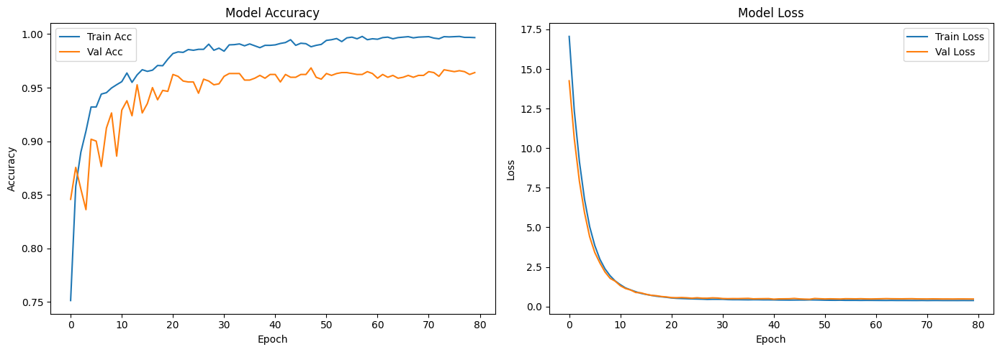

72/72 ━━━━━━━━━━━━━━━━━━━━ 3s 42ms/step - accuracy: 0.9770 - loss: 0.4268



Final Validation Accuracy: 0.9684
Final Validation Loss: 0.4563


In [ ]:
# import os
# import zipfile
# import numpy as np
# import matplotlib.pyplot as plt
# from tensorflow.keras.applications import ResNet50V2
# from tensorflow.keras.preprocessing.image import ImageDataGenerator
# from tensorflow.keras.layers import (GlobalAveragePooling2D, Dense, Dropout, BatchNormalization,
#                                      Multiply, Conv2D, Activation, Reshape, Concatenate, Layer, Input)
# from tensorflow.keras.models import Model
# from tensorflow.keras.optimizers import Adam
# from tensorflow.keras.callbacks import ModelCheckpoint, EarlyStopping, ReduceLROnPlateau, LearningRateScheduler
# from tensorflow.keras.regularizers import l2
# from tensorflow.keras import backend as K
# from tensorflow.keras.losses import CategoricalCrossentropy
# from sklearn.utils.class_weight import compute_class_weight
# from PIL import Image
# import tensorflow as tf
# import random

# # ======================
# # 1. CBAM LAYER IMPLEMENTATION
# # ======================
# class ChannelAttention(Layer):
#     def __init__(self, ratio=8, **kwargs):
#         super(ChannelAttention, self).__init__(**kwargs)
#         self.ratio = ratio

#     def build(self, input_shape):
#         self.channel = input_shape[-1]
#         self.shared_dense_one = Dense(self.channel // self.ratio, activation='swish')
#         self.shared_dense_two = Dense(self.channel, activation='sigmoid')
#         super(ChannelAttention, self).build(input_shape)

#     def call(self, inputs):
#         avg_pool = K.mean(inputs, axis=[1, 2], keepdims=True)
#         max_pool = K.max(inputs, axis=[1, 2], keepdims=True)
#         avg_out = self.shared_dense_two(self.shared_dense_one(avg_pool))
#         max_out = self.shared_dense_two(self.shared_dense_one(max_pool))
#         return Multiply()([inputs, avg_out + max_out])

# class SpatialAttention(Layer):
#     def __init__(self, kernel_size=7, **kwargs):
#         super(SpatialAttention, self).__init__(**kwargs)
#         self.conv = Conv2D(1, kernel_size, padding='same', activation='sigmoid')

#     def call(self, inputs):
#         avg_pool = K.mean(inputs, axis=-1, keepdims=True)
#         max_pool = K.max(inputs, axis=-1, keepdims=True)
#         concat = Concatenate()([avg_pool, max_pool])
#         spatial = self.conv(concat)
#         return Multiply()([inputs, spatial])

# class CBAM(Layer):
#     def __init__(self, ratio=8, kernel_size=7, **kwargs):
#         super(CBAM, self).__init__(**kwargs)
#         self.channel_attention = ChannelAttention(ratio)
#         self.spatial_attention = SpatialAttention(kernel_size)

#     def call(self, inputs):
#         x = self.channel_attention(inputs)
#         return self.spatial_attention(x)

# # ======================
# # 2. DATA PREPARATION
# # ======================
# def load_data():
#     zip_path = 'brain-tumor-mri-dataset.zip'
#     extract_dir = 'brain_tumor_datasets'

#     if not os.path.exists(extract_dir):
#         with zipfile.ZipFile(zip_path, 'r') as zip_ref:
#             zip_ref.extractall(extract_dir)

#     train_dir = os.path.join(extract_dir, 'Training')

#     # Augmentation
#     train_datagen = ImageDataGenerator(
#         rescale=1./255,
#         rotation_range=45,
#         width_shift_range=0.25,
#         height_shift_range=0.25,
#         shear_range=0.2,
#         zoom_range=0.3,
#         brightness_range=[0.7, 1.3],
#         horizontal_flip=True,
#         vertical_flip=True,
#         fill_mode='reflect',
#         validation_split=0.2
#     )

#     val_datagen = ImageDataGenerator(
#         rescale=1./255,
#         validation_split=0.2
#     )

#     train_generator = train_datagen.flow_from_directory(
#         train_dir,
#         target_size=(224, 224),
#         batch_size=16,  # Reduced batch size
#         class_mode='categorical',
#         subset='training',
#         shuffle=True,
#         seed=42
#     )

#     val_generator = val_datagen.flow_from_directory(
#         train_dir,
#         target_size=(224, 224),
#         batch_size=16,  # Reduced batch size
#         class_mode='categorical',
#         subset='validation',
#         shuffle=False,
#         seed=42
#     )

#     return train_generator, val_generator

# # ======================
# # 3. RESNET50V2 + CBAM MODEL
# # ======================
# def build_model():
#     base_model = ResNet50V2(
#         weights='imagenet',
#         include_top=False,
#         input_shape=(224, 224, 3)
#     )

#     for layer in base_model.layers[:100]:
#         layer.trainable = False

#     x1 = base_model.get_layer('conv3_block4_out').output
#     x1 = CBAM()(x1)
#     x1 = GlobalAveragePooling2D()(x1)

#     x2 = base_model.get_layer('conv4_block6_out').output
#     x2 = CBAM()(x2)
#     x2 = GlobalAveragePooling2D()(x2)

#     x3 = base_model.output
#     x3 = CBAM()(x3)
#     x3 = GlobalAveragePooling2D()(x3)

#     fused = Concatenate()([x1, x2, x3])

#     x = Dense(1024, kernel_regularizer=l2(0.01))(fused)
#     x = BatchNormalization()(x)
#     x = Activation('swish')(x)
#     x = Dropout(0.6)(x)

#     x = Dense(512, kernel_regularizer=l2(0.005))(x)
#     x = BatchNormalization()(x)
#     x = Activation('swish')(x)
#     x = Dropout(0.5)(x)

#     predictions = Dense(4, activation='softmax')(x)

#     return Model(inputs=base_model.input, outputs=predictions)

# # ======================
# # 4. TRAINING LOOP
# # ======================
# def train_and_evaluate():
#     train_gen, val_gen = load_data()
#     model = build_model()

#     class_weights = compute_class_weight(
#         class_weight='balanced',
#         classes=np.unique(train_gen.classes),
#         y=train_gen.labels
#     )
#     class_weights = dict(enumerate(class_weights))

#     def lr_schedule(epoch):
#         if epoch < 20:
#             return 1e-4
#         elif epoch < 50:
#             return 5e-5
#         else:
#             return 1e-5

#     callbacks = [
#         ModelCheckpoint('best_model.h5', monitor='val_accuracy', save_best_only=True, verbose=1),
#         EarlyStopping(monitor='val_loss', patience=50, restore_best_weights=True),
#         ReduceLROnPlateau(monitor='val_loss', factor=0.5, patience=5, min_lr=1e-6),
#         LearningRateScheduler(lr_schedule)
#     ]

#     model.compile(
#         optimizer=Adam(learning_rate=1e-4),  # Optimized learning rate
#         loss=CategoricalCrossentropy(label_smoothing=0.1),
#         metrics=['accuracy']
#     )

#     history = model.fit(
#         train_gen,
#         validation_data=val_gen,
#         epochs=80,
#         callbacks=callbacks,
#         class_weight=class_weights
#     )

#     # Plot
#     plt.figure(figsize=(14, 5))

#     plt.subplot(1, 2, 1)
#     plt.plot(history.history['accuracy'], label='Train Acc')
#     plt.plot(history.history['val_accuracy'], label='Val Acc')
#     plt.title("Model Accuracy")
#     plt.xlabel("Epoch")
#     plt.ylabel("Accuracy")
#     plt.legend()

#     plt.subplot(1, 2, 2)
#     plt.plot(history.history['loss'], label='Train Loss')
#     plt.plot(history.history['val_loss'], label='Val Loss')
#     plt.title("Model Loss")
#     plt.xlabel("Epoch")
#     plt.ylabel("Loss")
#     plt.legend()

#     plt.tight_layout()
#     plt.savefig('training_history.png')
#     plt.show()

#     val_loss, val_acc = model.evaluate(val_gen)
#     print(f"\nFinal Validation Accuracy: {val_acc:.4f}")
#     print(f"Final Validation Loss: {val_loss:.4f}")

#     return model

# # ======================
# # 5. MAIN EXECUTION
# # ======================
# if __name__ == "__main__":
#     trained_model = train_and_evaluate()
#     trained_model.save('brain_tumor_cbam_model.h5')


# **GRAD-CAM**

In [ ]:
import os
import random
import numpy as np
import tensorflow as tf
import matplotlib.pyplot as plt
import cv2
from tensorflow.keras.preprocessing.image import load_img, img_to_array
from tensorflow.keras.models import load_model

# Load model and class names

model = load_model('brain_tumor_cbam_mode2.h5', custom_objects={'ChannelAttention': ChannelAttention,'SpatialAttention': SpatialAttention,'CBAM': CBAM})

class_names = ['glioma', 'meningioma', 'notumor', 'pituitary']
img_width, img_height = 224, 224

# Grad-CAM Function
def get_gradcam_heatmap(img_array, model, last_conv_layer_name, pred_index=None):
    grad_model = tf.keras.models.Model([model.inputs], [model.get_layer(last_conv_layer_name).output, model.output])
    with tf.GradientTape() as tape:
        conv_outputs, predictions = grad_model(img_array)
        if pred_index is None:
            pred_index = tf.argmax(predictions[0])
        loss = predictions[:, pred_index]
    grads = tape.gradient(loss, conv_outputs)
    pooled_grads = tf.reduce_mean(grads, axis=(0, 1, 2))
    conv_outputs = conv_outputs[0]
    heatmap = conv_outputs @ pooled_grads[..., tf.newaxis]
    heatmap = tf.squeeze(heatmap)
    heatmap = tf.maximum(heatmap, 0) / tf.math.reduce_max(heatmap)
    return heatmap.numpy()

# Counterfactual using Grad-CAM region
def generate_cf_with_gradcam(model, input_image, heatmap, target_class, max_iter=300, lr=0.1, lambda_val=0.25):
    cf_image = tf.Variable(input_image, dtype=tf.float32)
    optimizer = tf.optimizers.Adam(learning_rate=lr)

    # Resize heatmap to match input shape (224x224)
    mask = cv2.resize(heatmap, (img_width, img_height))
    mask = np.expand_dims(mask, axis=-1)  # shape (224, 224, 1)
    mask = tf.convert_to_tensor(mask, dtype=tf.float32)

    for _ in range(max_iter):
        with tf.GradientTape() as tape:
            preds = model(cf_image)
            classification_loss = tf.keras.losses.sparse_categorical_crossentropy(tf.constant([target_class]), preds)
            masked_diff = (cf_image - input_image) * mask  # only modify important pixels
            similarity_loss = tf.norm(masked_diff, ord=1)
            total_loss = classification_loss + lambda_val * similarity_loss

        gradients = tape.gradient(total_loss, [cf_image])
        optimizer.apply_gradients(zip(gradients, [cf_image]))
        cf_image.assign(tf.clip_by_value(cf_image, 0.0, 1.0))

        if tf.argmax(preds[0]).numpy() == target_class:
            break

    return cf_image


# **CF**

/usr/local/lib/python3.11/dist-packages/keras/src/models/functional.py:237: UserWarning: The structure of `inputs` doesn't match the expected structure.
Expected: [['input_layer_1']]
Received: inputs=Tensor(shape=(1, 224, 224, 3))
  warnings.warn(msg)


error: OpenCV(4.11.0) /io/opencv/modules/core/src/arithm.cpp:662: error: (-209:Sizes of input arguments do not match) The operation is neither 'array op array' (where arrays have the same size and the same number of channels), nor 'array op scalar', nor 'scalar op array' in function 'arithm_op'


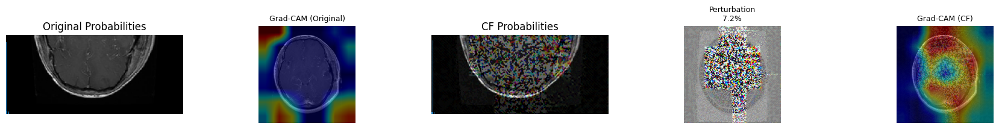

In [ ]:
import os, random, cv2
import numpy as np
import matplotlib.pyplot as plt
from keras.preprocessing.image import load_img, img_to_array

# Parameters
img_width, img_height = 224, 224
class_flip_count = 0
total_pixel_change = 0
total_conf_drop = 0

# Load up to 50 random images from dataset
image_dir = os.path.join('brain_tumor_datasets', 'Training')
img_extensions = ('.jpg', '.jpeg', '.png')
img_paths = []

for class_folder in os.listdir(image_dir):
    folder_path = os.path.join(image_dir, class_folder)
    if os.path.isdir(folder_path):
        img_paths.extend([
            os.path.join(folder_path, f)
            for f in os.listdir(folder_path)
            if f.lower().endswith(img_extensions)
        ])

# Pick 50 random images
random.shuffle(img_paths)
selected_imgs = img_paths[:50]

plt.figure(figsize=(22, len(selected_imgs) * 2.5))

for idx, path in enumerate(selected_imgs):
    img = load_img(path, target_size=(img_width, img_height))
    img_array = img_to_array(img) / 255.0
    input_image = np.expand_dims(img_array, axis=0)

    # Original prediction
    orig_probs = model.predict(input_image, verbose=0)[0]
    orig_class = np.argmax(orig_probs)

    # Pick worst-performing alternate class
    valid_targets = [i for i in range(4) if i != orig_class]
    target_class = valid_targets[np.argmin(orig_probs[valid_targets])]

    # Grad-CAM (Original)
    heatmap = get_gradcam_heatmap(input_image, model, 'conv5_block3_out')
    gradcam_colormap = cv2.applyColorMap(np.uint8(255 * cv2.resize(heatmap, (224, 224))), cv2.COLORMAP_JET)
    gradcam_output = cv2.addWeighted(np.uint8(img_array * 255), 0.6, gradcam_colormap, 0.4, 0)

    # Generate Counterfactual Image
    cf_image = generate_cf_with_gradcam(model, input_image, heatmap, target_class)
    cf_array = cf_image[0].numpy()

    # Perturbation map
    perturbation = cf_array - img_array
    pert_map = (perturbation - perturbation.min()) / (perturbation.max() - perturbation.min() + 1e-8)

    # CF prediction
    cf_probs = model.predict(np.expand_dims(cf_array, axis=0), verbose=0)[0]
    cf_pred = np.argmax(cf_probs)

    pixel_change_percent = np.mean(np.abs(perturbation)) * 100
    orig_conf = orig_probs[orig_class] * 100
    cf_conf = cf_probs[cf_pred] * 100
    conf_drop = orig_conf - cf_probs[orig_class] * 100

    if cf_pred != orig_class:
        class_flip_count += 1

    total_pixel_change += pixel_change_percent
    total_conf_drop += conf_drop

    # Grad-CAM (Counterfactual)
    cf_heatmap = get_gradcam_heatmap(np.expand_dims(cf_array, axis=0), model, 'conv5_block3_out')
    cf_colormap = cv2.applyColorMap(np.uint8(255 * cv2.resize(cf_heatmap, (224, 224))), cv2.COLORMAP_JET)
    cf_gradcam_output = cv2.addWeighted(np.uint8(cf_array * 255), 0.6, cf_colormap, 0.4, 0)

    # Plotting
    i = idx * 5
    plt.subplot(len(selected_imgs), 5, i+1)
    plt.imshow(img_array)
    plt.title(f"Original\n{class_names[orig_class]}\n{orig_conf:.1f}%", fontsize=9)
    plt.axis('off')

    plt.subplot(len(selected_imgs), 5, i+2)
    plt.imshow(cv2.cvtColor(gradcam_output, cv2.COLOR_BGR2RGB))
    plt.title("Grad-CAM (Original)", fontsize=9)
    plt.axis('off')

    plt.subplot(len(selected_imgs), 5, i+3)
    plt.imshow(cf_array)
    plt.title(f"Counterfactual\n→ {class_names[cf_pred]}\n{cf_conf:.1f}%", fontsize=9)
    plt.axis('off')

    plt.subplot(len(selected_imgs), 5, i+4)
    plt.imshow(pert_map, cmap='hot')
    plt.title(f"Perturbation\n{pixel_change_percent:.1f}%", fontsize=9)
    plt.axis('off')

    plt.subplot(len(selected_imgs), 5, i+5)
    plt.imshow(cv2.cvtColor(cf_gradcam_output, cv2.COLOR_BGR2RGB))
    plt.title("Grad-CAM (CF)", fontsize=9)
    plt.axis('off')

    # Add full probability bars
    plt.subplot(len(selected_imgs), 5, i+1)
    plt.bar(range(4), orig_probs * 100)
    plt.xticks(range(4), class_names, rotation=45)
    plt.title("Original Probabilities")
    plt.ylim(0, 100)

    plt.subplot(len(selected_imgs), 5, i+3)
    plt.bar(range(4), cf_probs * 100)
    plt.xticks(range(4), class_names, rotation=45)
    plt.title("CF Probabilities")
    plt.ylim(0, 100)

    # Overlay heatmap on counterfactual perturbation
    blended_map = cv2.addWeighted(pert_map, 0.5, cf_heatmap, 0.5, 0)
    plt.subplot(len(selected_imgs), 5, i+2)
    plt.imshow(blended_map, cmap='hot')
    plt.title("Perturbation × Grad-CAM")
    plt.axis('off')

    # Highlight critical pixels in perturbation map
    threshold = np.percentile(np.abs(perturbation), 95)
    mask = np.abs(perturbation) >= threshold
    highlighted = np.where(mask, 1.0, 0.0)
    plt.subplot(len(selected_imgs), 5, i+4)
    plt.imshow(highlighted, cmap='gray')
    plt.title("Top 5% Pixel Changes")
    plt.axis('off')

plt.tight_layout()
plt.show()

# --------- Summary Metrics ---------
total_imgs = len(selected_imgs)
class_flip_rate = (class_flip_count / total_imgs) * 100
avg_pixel_change = total_pixel_change / total_imgs
avg_conf_drop = total_conf_drop / total_imgs

print(f"\nSummary Metrics over {total_imgs} images:")
print(f"✅ Class Flip Rate: {class_flip_rate:.1f}%")
print(f"📉 Avg Confidence Drop: {avg_conf_drop:.2f}%")
print(f"🎨 Avg Pixel Change: {avg_pixel_change:.2f}%")


/usr/local/lib/python3.11/dist-packages/keras/src/models/functional.py:237: UserWarning: The structure of `inputs` doesn't match the expected structure.
Expected: [['input_layer_1']]
Received: inputs=Tensor(shape=(1, 224, 224, 3))
  warnings.warn(msg)


error: OpenCV(4.11.0) /io/opencv/modules/core/src/arithm.cpp:662: error: (-209:Sizes of input arguments do not match) The operation is neither 'array op array' (where arrays have the same size and the same number of channels), nor 'array op scalar', nor 'scalar op array' in function 'arithm_op'


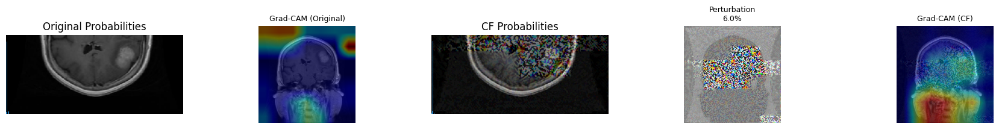

In [ ]:
import os, random, cv2
import numpy as np
import matplotlib.pyplot as plt
from keras.preprocessing.image import load_img, img_to_array

# Parameters
img_width, img_height = 224, 224
class_flip_count = 0
total_pixel_change = 0
total_conf_drop = 0

# Load up to 50 random images from dataset
image_dir = os.path.join('brain_tumor_datasets', 'Training')
img_extensions = ('.jpg', '.jpeg', '.png')
img_paths = []

for class_folder in os.listdir(image_dir):
    folder_path = os.path.join(image_dir, class_folder)
    if os.path.isdir(folder_path):
        img_paths.extend([
            os.path.join(folder_path, f)
            for f in os.listdir(folder_path)
            if f.lower().endswith(img_extensions)
        ])

# Pick 50 random images
random.shuffle(img_paths)
selected_imgs = img_paths[:50]

plt.figure(figsize=(22, len(selected_imgs) * 2.5))

for idx, path in enumerate(selected_imgs):
    img = load_img(path, target_size=(img_width, img_height))
    img_array = img_to_array(img) / 255.0
    input_image = np.expand_dims(img_array, axis=0)

    # Original prediction
    orig_probs = model.predict(input_image, verbose=0)[0]
    orig_class = np.argmax(orig_probs)

    # Pick worst-performing alternate class
    valid_targets = [i for i in range(4) if i != orig_class]
    target_class = valid_targets[np.argmin(orig_probs[valid_targets])]

    # Grad-CAM (Original)
    heatmap = get_gradcam_heatmap(input_image, model, 'conv5_block3_out')
    gradcam_colormap = cv2.applyColorMap(np.uint8(255 * cv2.resize(heatmap, (224, 224))), cv2.COLORMAP_JET)
    gradcam_output = cv2.addWeighted(np.uint8(img_array * 255), 0.6, gradcam_colormap, 0.4, 0)

    # Generate Counterfactual Image
    cf_image = generate_cf_with_gradcam(model, input_image, heatmap, target_class)
    cf_array = cf_image[0].numpy()

    # Perturbation map
    perturbation = cf_array - img_array
    pert_map = (perturbation - perturbation.min()) / (perturbation.max() - perturbation.min() + 1e-8)

    # CF prediction
    cf_probs = model.predict(np.expand_dims(cf_array, axis=0), verbose=0)[0]
    cf_pred = np.argmax(cf_probs)

    pixel_change_percent = np.mean(np.abs(perturbation)) * 100
    orig_conf = orig_probs[orig_class] * 100
    cf_conf = cf_probs[cf_pred] * 100
    conf_drop = orig_conf - cf_probs[orig_class] * 100

    if cf_pred != orig_class:
        class_flip_count += 1

    total_pixel_change += pixel_change_percent
    total_conf_drop += conf_drop

    # Grad-CAM (Counterfactual)
    cf_heatmap = get_gradcam_heatmap(np.expand_dims(cf_array, axis=0), model, 'conv5_block3_out')
    cf_colormap = cv2.applyColorMap(np.uint8(255 * cv2.resize(cf_heatmap, (224, 224))), cv2.COLORMAP_JET)
    cf_gradcam_output = cv2.addWeighted(np.uint8(cf_array * 255), 0.6, cf_colormap, 0.4, 0)

    # Plotting
    i = idx * 5
    plt.subplot(len(selected_imgs), 5, i+1)
    plt.imshow(img_array)
    plt.title(f"Original\n{class_names[orig_class]}\n{orig_conf:.1f}%", fontsize=9)
    plt.axis('off')

    plt.subplot(len(selected_imgs), 5, i+2)
    plt.imshow(cv2.cvtColor(gradcam_output, cv2.COLOR_BGR2RGB))
    plt.title("Grad-CAM (Original)", fontsize=9)
    plt.axis('off')

    plt.subplot(len(selected_imgs), 5, i+3)
    plt.imshow(cf_array)
    plt.title(f"Counterfactual\n→ {class_names[cf_pred]}\n{cf_conf:.1f}%", fontsize=9)
    plt.axis('off')

    plt.subplot(len(selected_imgs), 5, i+4)
    plt.imshow(pert_map, cmap='hot')
    plt.title(f"Perturbation\n{pixel_change_percent:.1f}%", fontsize=9)
    plt.axis('off')

    plt.subplot(len(selected_imgs), 5, i+5)
    plt.imshow(cv2.cvtColor(cf_gradcam_output, cv2.COLOR_BGR2RGB))
    plt.title("Grad-CAM (CF)", fontsize=9)
    plt.axis('off')

    # Add full probability bars
    plt.subplot(len(selected_imgs), 5, i+1)
    plt.bar(range(4), orig_probs * 100)
    plt.xticks(range(4), class_names, rotation=45)
    plt.title("Original Probabilities")
    plt.ylim(0, 100)

    plt.subplot(len(selected_imgs), 5, i+3)
    plt.bar(range(4), cf_probs * 100)
    plt.xticks(range(4), class_names, rotation=45)
    plt.title("CF Probabilities")
    plt.ylim(0, 100)

    # Overlay heatmap on counterfactual perturbation
    # Ensure pert_map and cf_heatmap are the same size
    pert_map_resized = cv2.resize(pert_map, (224, 224))  # Resize perturbation map to 224x224

    # Ensure both maps are of the same type (uint8 for addWeighted)
    pert_map_resized = np.uint8(255 * pert_map_resized)  # Scale to 255 for uint8
    cf_heatmap_resized = np.uint8(255 * cv2.resize(cf_heatmap, (224, 224)))  # Resize and scale

    # Now blend them
    blended_map = cv2.addWeighted(pert_map_resized, 0.5, cf_heatmap_resized, 0.5, 0)

    plt.subplot(len(selected_imgs), 5, i+2)
    plt.imshow(blended_map, cmap='hot')
    plt.title("Perturbation × Grad-CAM")
    plt.axis('off')

    # Highlight critical pixels in perturbation map
    threshold = np.percentile(np.abs(perturbation), 95)
    mask = np.abs(perturbation) >= threshold
    highlighted = np.where(mask, 1.0, 0.0)
    plt.subplot(len(selected_imgs), 5, i+4)
    plt.imshow(highlighted, cmap='gray')
    plt.title("Top 5% Pixel Changes")
    plt.axis('off')

plt.tight_layout()
plt.show()

# --------- Summary Metrics ---------
total_imgs = len(selected_imgs)
class_flip_rate = (class_flip_count / total_imgs) * 100
avg_pixel_change = total_pixel_change / total_imgs
avg_conf_drop = total_conf_drop / total_imgs

print(f"\nSummary Metrics over {total_imgs} images:")
print(f"✅ Class Flip Rate: {class_flip_rate:.1f}%")
print(f"📉 Avg Confidence Drop: {avg_conf_drop:.2f}%")
print(f"🎨 Avg Pixel Change: {avg_pixel_change:.2f}%")

# **CF2**

/usr/local/lib/python3.11/dist-packages/keras/src/models/functional.py:237: UserWarning: The structure of `inputs` doesn't match the expected structure.
Expected: [['input_layer_1']]
Received: inputs=Tensor(shape=(1, 224, 224, 3))
  warnings.warn(msg)


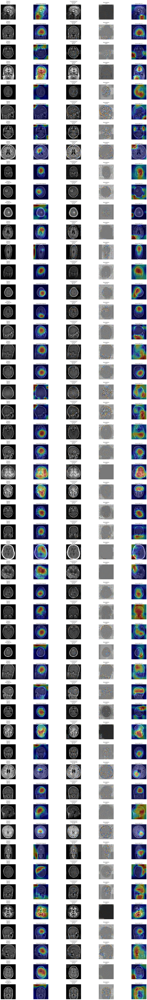


Summary Metrics over 50 images:
✅ Class Flip Rate: 78.0%
📉 Avg Confidence Drop: 67.97%
🎨 Avg Pixel Change: 6.43%


In [ ]:
import os, random, cv2
import numpy as np
import matplotlib.pyplot as plt
from keras.preprocessing.image import load_img, img_to_array

# Parameters
img_width, img_height = 224, 224
class_flip_count = 0
total_pixel_change = 0
total_conf_drop = 0

# Load up to 50 random images from dataset
image_dir = os.path.join('brain_tumor_datasets', 'Training')
img_extensions = ('.jpg', '.jpeg', '.png')
img_paths = []

for class_folder in os.listdir(image_dir):
    folder_path = os.path.join(image_dir, class_folder)
    if os.path.isdir(folder_path):
        img_paths.extend([
            os.path.join(folder_path, f)
            for f in os.listdir(folder_path)
            if f.lower().endswith(img_extensions)
        ])

# Pick 50 random images
random.shuffle(img_paths)
selected_imgs = img_paths[:50]

plt.figure(figsize=(22, len(selected_imgs) * 2.5))

for idx, path in enumerate(selected_imgs):
    img = load_img(path, target_size=(img_width, img_height))
    img_array = img_to_array(img) / 255.0
    input_image = np.expand_dims(img_array, axis=0)

    # Original prediction
    orig_probs = model.predict(input_image, verbose=0)[0]
    orig_class = np.argmax(orig_probs)

    # Pick worst-performing alternate class
    valid_targets = [i for i in range(4) if i != orig_class]
    target_class = valid_targets[np.argmin(orig_probs[valid_targets])]

    # Grad-CAM (Original)
    heatmap = get_gradcam_heatmap(input_image, model, 'conv5_block3_out')
    gradcam_colormap = cv2.applyColorMap(np.uint8(255 * cv2.resize(heatmap, (224, 224))), cv2.COLORMAP_JET)
    gradcam_output = cv2.addWeighted(np.uint8(img_array * 255), 0.6, gradcam_colormap, 0.4, 0)

    # Generate Counterfactual Image
    cf_image = generate_cf_with_gradcam(model, input_image, heatmap, target_class)
    cf_array = cf_image[0].numpy()

    # Perturbation map
    perturbation = cf_array - img_array
    pert_map = (perturbation - perturbation.min()) / (perturbation.max() - perturbation.min() + 1e-8)

    # CF prediction
    cf_probs = model.predict(np.expand_dims(cf_array, axis=0), verbose=0)[0]
    cf_pred = np.argmax(cf_probs)

    pixel_change_percent = np.mean(np.abs(perturbation)) * 100
    orig_conf = orig_probs[orig_class] * 100
    cf_conf = cf_probs[cf_pred] * 100
    conf_drop = orig_conf - cf_probs[orig_class] * 100

    if cf_pred != orig_class:
        class_flip_count += 1

    total_pixel_change += pixel_change_percent
    total_conf_drop += conf_drop

    # Grad-CAM (Counterfactual)
    cf_heatmap = get_gradcam_heatmap(np.expand_dims(cf_array, axis=0), model, 'conv5_block3_out')
    cf_colormap = cv2.applyColorMap(np.uint8(255 * cv2.resize(cf_heatmap, (224, 224))), cv2.COLORMAP_JET)
    cf_gradcam_output = cv2.addWeighted(np.uint8(cf_array * 255), 0.6, cf_colormap, 0.4, 0)

    # Plotting
    i = idx * 5
    plt.subplot(len(selected_imgs), 5, i+1)
    plt.imshow(img_array)
    plt.title(f"Original\n{class_names[orig_class]}\n{orig_conf:.1f}%", fontsize=9)
    plt.axis('off')

    plt.subplot(len(selected_imgs), 5, i+2)
    plt.imshow(cv2.cvtColor(gradcam_output, cv2.COLOR_BGR2RGB))
    plt.title("Grad-CAM (Original)", fontsize=9)
    plt.axis('off')

    plt.subplot(len(selected_imgs), 5, i+3)
    plt.imshow(cf_array)
    plt.title(f"Counterfactual\n→ {class_names[cf_pred]}\n{cf_conf:.1f}%", fontsize=9)
    plt.axis('off')

    plt.subplot(len(selected_imgs), 5, i+4)
    plt.imshow(pert_map, cmap='hot')
    plt.title(f"Perturbation\n{pixel_change_percent:.1f}%", fontsize=9)
    plt.axis('off')

    plt.subplot(len(selected_imgs), 5, i+5)
    plt.imshow(cv2.cvtColor(cf_gradcam_output, cv2.COLOR_BGR2RGB))
    plt.title("Grad-CAM (CF)", fontsize=9)
    plt.axis('off')

plt.tight_layout()
plt.show()

# --------- Summary Metrics ---------
total_imgs = len(selected_imgs)
class_flip_rate = (class_flip_count / total_imgs) * 100
avg_pixel_change = total_pixel_change / total_imgs
avg_conf_drop = total_conf_drop / total_imgs

print(f"\nSummary Metrics over {total_imgs} images:")
print(f"✅ Class Flip Rate: {class_flip_rate:.1f}%")
print(f"📉 Avg Confidence Drop: {avg_conf_drop:.2f}%")
print(f"🎨 Avg Pixel Change: {avg_pixel_change:.2f}%")
